# Домашнее задание №1

В этом домашнем задании вам предлагается обучить модель регрессии для предсказания стоимости автомобилей, а также реализовать веб-сервис для применения построенной модели на новых данных.

> Оценка за домашку = min(ваш балл, 10)


Задания, <font color='#9933CC'>выделенные фиолетовым</font>, требуют от вас написания кода.

А вопросы, <font color='#FF6600'>выделенные оранжевым</font>, текстового ответа.

Оцениваются как код, так и ответы на вопросы. Если нет одного и/или другого, то часть баллов за соответствующее задание без колебаний снимается.

In [76]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns

from sklearn.model_selection import GridSearchCV
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.linear_model import Lasso
%matplotlib inline

random.seed(42)
np.random.seed(42)

Ниже ответьте на вопрос <font color='#FF6600'>
"Для чего фиксируем сиды в домашках?"</font>

In [3]:
print("Для того, чтобы проверяющий работу смог получить те же результаты, что и студент. ")

# https://dev-gang.ru/article/python-kak-ispolzovat-metod-randomseed-1n9kvinjt9/

Для того, чтобы проверяющий работу смог получить те же результаты, что и студент. 


# Часть 1 (2.5 балла + 0.75) | EDA

## Простейший EDA и обработка признаков (1.5 балла + 0.25)

In [4]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


(0.15 балла) <font color='#9933CC'>Отобразите 10 **случайных** строк тренировочного датасета</font>

In [5]:
# your code here
df_train.sample(10, random_state = 1)
# http://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.sample.html

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
2305,Honda Amaze V CVT Petrol BSIV,2019,779000,7032,Petrol,Trustmark Dealer,Automatic,First Owner,19.0 kmpl,1199 CC,88.76 bhp,110Nm@ 4800rpm,5.0
4387,Hyundai Creta 1.6 CRDi SX Plus,2017,1150000,27000,Diesel,Individual,Manual,Second Owner,19.67 kmpl,1582 CC,126.2 bhp,259.9Nm@ 1900-2750rpm,5.0
1686,Honda City i VTEC V,2017,860000,28000,Petrol,Individual,Manual,First Owner,17.8 kmpl,1497 CC,117.3 bhp,145Nm@ 4600rpm,5.0
4706,Ford Figo Diesel LXI,2012,225000,60000,Diesel,Individual,Manual,First Owner,20.0 kmpl,1399 CC,68 bhp,160Nm@ 2000rpm,5.0
6737,Honda Mobilio S i VTEC,2017,600000,70000,Petrol,Individual,Manual,First Owner,17.3 kmpl,1497 CC,117.3 bhp,145Nm@ 4600rpm,7.0
1651,Ford Endeavour 3.2 Titanium AT 4X4,2016,2280000,120000,Diesel,Individual,Automatic,Second Owner,10.91 kmpl,3198 CC,197 bhp,470Nm@ 1750-2500rpm,7.0
1528,Maruti Swift 1.3 VXi,2007,150000,70000,Petrol,Individual,Manual,Third Owner,NaN,NaN,NaN,NaN,NaN
6548,Maruti Wagon R VXI 1.2,2015,365000,28000,Petrol,Dealer,Manual,First Owner,20.52 kmpl,1197 CC,81.80 bhp,113Nm@ 4200rpm,5.0
6188,Honda City i DTec VX,2016,1000000,50000,Diesel,Individual,Manual,Second Owner,26.0 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0
5388,Hyundai EON Era,2014,225000,35000,Petrol,Individual,Manual,First Owner,21.1 kmpl,814 CC,55.2 bhp,74.5Nm@ 4000rpm,5.0


(0.1 балла) <font color='#9933CC'>Отобразите первые 5 и последние 5 объектов тестового датасета</font>

In [6]:
# your code here
df1 = df_test.head(5) # первые 5
df2 = df_test.tail(5) # последние 5
df_concat = pd.concat([df1, df2], axis=0) # склеиваю первые 5 и последние 5 строк
df_concat

# https://pyprog.pro/pd/pd_14_data_manipulation_1.html 
# https://rukovodstvo.net/posts/id_606/ 

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0 kmpl,2498 CC,112 bhp,260 Nm at 1800-2200 rpm,7.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.5 kmpl,1497 CC,108.5 bhp,260Nm@ 1500-2750rpm,5.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.9 kmpl,1799 CC,130 bhp,172Nm@ 4300rpm,5.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.1 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.5 kmpl,1172 CC,65 bhp,96 Nm at 3000 rpm,5.0
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81 kmpl,1086 CC,68.05 bhp,99.04Nm@ 4500rpm,5.0
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,81.83 bhp,114.7Nm@ 4000rpm,5.0
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36 kmpl,1197 CC,78.9 bhp,111.8Nm@ 4000rpm,5.0
999,Honda City i DTec SV,2016,700000,110000,Diesel,Individual,Manual,First Owner,26.0 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0


(0.1 балла) <font color='#9933CC'>Посчитайте основные статистики как по числовым, так и по категориальным столбцам для трейна и теста</font>. 
> Подсказка: ``.describe()`` с нужным(и) аргументом(-ами)



In [7]:
df_train.describe(include = 'all') # основные статистики для train'a

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
count,6999,6999.000000,6.999000e+03,6.999000e+03,6999,6999,6999,6999,6797,6797,6803,6796,6797.000000
unique,1924,NaN,NaN,NaN,4,3,2,5,386,120,316,419,NaN
top,Maruti Swift Dzire VDI,NaN,NaN,NaN,Diesel,Individual,Manual,First Owner,18.9 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,NaN
freq,116,NaN,NaN,NaN,3793,5826,6095,4587,197,885,330,468,NaN
mean,NaN,2013.818403,6.395152e+05,6.958462e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.419008
std,NaN,4.053095,8.089419e+05,5.772400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.965767
min,NaN,1983.000000,2.999900e+04,1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000
25%,NaN,2011.000000,2.549990e+05,3.500000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000
50%,NaN,2015.000000,4.500000e+05,6.000000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000
75%,NaN,2017.000000,6.750000e+05,9.700000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000


In [8]:
df_test.describe(include = 'all') # основные статистики для test'a

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
count,1000,1000.000000,1.000000e+03,1000.000000,1000,1000,1000,1000,981,981,981,981,981.000000
unique,621,NaN,NaN,NaN,4,3,2,5,237,88,182,226,NaN
top,Maruti Alto 800 LXI,NaN,NaN,NaN,Diesel,Individual,Manual,First Owner,18.6 kmpl,1248 CC,74 bhp,200Nm@ 1750rpm,NaN
freq,15,NaN,NaN,NaN,534,837,877,623,23,116,43,57,NaN
mean,NaN,2013.681000,6.179010e+05,71393.341000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.410805
std,NaN,4.012149,7.585539e+05,48486.218662,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.919985
min,NaN,1995.000000,3.100000e+04,1303.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000
25%,NaN,2011.000000,2.500000e+05,37000.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000
50%,NaN,2014.000000,4.349990e+05,61500.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000
75%,NaN,2017.000000,6.700000e+05,100000.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000


(0.15 балла) <font color='#9933CC'>Посмотрите, есть ли в датасете пропуски.</font>

<font color='#FF6600'>Если есть, то в каких колонках?</font>

In [9]:
df_train.info() # смотрим на общую информацию по датасету

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6999 entries, 0 to 6998
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           6999 non-null   object 
 1   year           6999 non-null   int64  
 2   selling_price  6999 non-null   int64  
 3   km_driven      6999 non-null   int64  
 4   fuel           6999 non-null   object 
 5   seller_type    6999 non-null   object 
 6   transmission   6999 non-null   object 
 7   owner          6999 non-null   object 
 8   mileage        6797 non-null   object 
 9   engine         6797 non-null   object 
 10  max_power      6803 non-null   object 
 11  torque         6796 non-null   object 
 12  seats          6797 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 711.0+ KB


In [10]:
pd.isna(df_train).sum() # считаем сколько пропусков в train

name               0
year               0
selling_price      0
km_driven          0
fuel               0
seller_type        0
transmission       0
owner              0
mileage          202
engine           202
max_power        196
torque           203
seats            202
dtype: int64

In [11]:
pd.isna(df_test).sum() # считаем сколько пропусков в test

name              0
year              0
selling_price     0
km_driven         0
fuel              0
seller_type       0
transmission      0
owner             0
mileage          19
engine           19
max_power        19
torque           19
seats            19
dtype: int64

**Ответ:**
Пропуски встречаются в пяти признаках: mileage, engine, max_power, torque, seats  

(0.1 балла) <font color='#9933CC'>Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием</font> (целевую переменную следует исключить). Если есть, то сколько?

In [12]:
# В train'е 1159 дубликатов
temp = df_train.columns # список колонок датасета
double = [i for i in temp if i != 'selling_price'] # создаю список из колонок без таргета
df_train[df_train.duplicated(subset = double)].shape[0] # смотрю на число дублей

# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.duplicated.html

1159

In [13]:
# В test'е 69 дубликатов!
temp_test = df_test.columns # список колонок датасета
double_test = [i for i in temp_test if i != 'selling_price'] # создаю список из колонок без таргета
df_test[df_test.duplicated(subset = double)].shape[0] # смотрю на число дублей

# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.duplicated.html

69

(0.15 балла) <font color='#9933CC'>Отобразите такие объекты</font>

In [14]:
df_train[df_train.duplicated(subset = double)]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
254,Hyundai Grand i10 Sportz,2017,450000,35000,Petrol,Individual,Manual,First Owner,18.9 kmpl,1197 CC,82 bhp,114Nm@ 4000rpm,5.0
258,Maruti Swift VXI,2012,330000,50000,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,85.8 bhp,114Nm@ 4000rpm,5.0
268,Maruti Swift Dzire VXI,2014,400000,70000,Petrol,Individual,Manual,Second Owner,19.1 kmpl,1197 CC,85.8 bhp,114Nm@ 4000rpm,5.0
324,Jaguar XE 2016-2019 2.0L Diesel Prestige,2017,2625000,9000,Diesel,Dealer,Automatic,First Owner,13.6 kmpl,1999 CC,177 bhp,430Nm@ 1750-2500rpm,5.0
325,Lexus ES 300h,2019,5150000,20000,Petrol,Dealer,Automatic,First Owner,22.37 kmpl,2487 CC,214.56 bhp,202Nm@ 3600-5200rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6947,Chevrolet Spark 1.0 LS,2010,140000,60000,Petrol,Individual,Manual,Second Owner,18.0 kmpl,995 CC,62 bhp,90.3Nm@ 4200rpm,5.0
6984,Ford Freestyle Titanium Plus Diesel BSIV,2018,746000,24000,Diesel,Individual,Manual,First Owner,24.4 kmpl,1498 CC,98.63 bhp,215Nm@ 1750-3000rpm,5.0
6989,Maruti Swift Dzire VDI,2015,625000,50000,Diesel,Individual,Manual,First Owner,26.59 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
6997,Tata Indigo CR4,2013,290000,25000,Diesel,Individual,Manual,First Owner,23.57 kmpl,1396 CC,70 bhp,140Nm@ 1800-3000rpm,5.0


(0.15 балла) <font color='#9933CC'>Удалите повторяющиеся строки</font>. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю

In [15]:
df_train_new = df_train.drop_duplicates(subset = double, keep = 'first')
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.drop_duplicates.html#pandas.DataFrame.drop_duplicates

In [16]:
assert df_train_new.shape == (5840, 13)
# https://pythonru.com/uroki/35-instrukcija-assert-dlja-nachinajushhih

In [17]:
# assert df_train.shape == (5840, 13)

(0.1 балла) Чтоб все было по красоте, <font color='#9933CC'>обновите индексы строк таким образом, чтобы они шли от 0 без пропусков</font>

In [18]:
df_train = df_train.drop_duplicates(subset = double, keep = 'first', ignore_index=True)
# df_train

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не слава богу. Давайте починим.

(0.25 балла) Задача такая: 
<font color='#9933CC'>
* убрать единицы измерения для признаков ``mileage, engine, max_power``. 
* кастануть эти столбцы столбцы к ``float``.
* удалить столбец ``torque``
</font>

> Все действия нужно производить над обоими датасетами

---
**Доп (0.25 балла):**
* <font color='#9933CC'>Вместо удаления признак `torque` разделите на два: собственно `torque` и `max_torque_rpm`.</font> Учтите единицы измерения. Они разные ☹

In [19]:
# your code here
for i in range(df_train.shape[0]):
    val = df_train.loc[i,'mileage']
    if not val != val: # если не nan (val != val)
        df_train.loc[i, 'mileage'] = val.split()[0]
    
    val = df_train.loc[i,'engine']
    if not val != val: # если не nan (val != val)
        df_train.loc[i, 'engine'] = val.split()[0]
          
    val = df_train.loc[i,'max_power']
    if not val != val: # если не nan (val != val)
        df_train.loc[i, 'max_power'] = val.split()[0]    
df_train

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4,1248,74,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14,1498,103.52,250Nm@ 1500-2500rpm,5.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0,1396,90,22.4 kgm at 1750-2750rpm,5.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1,1298,88.2,"11.5@ 4,500(kgm@ rpm)",5.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14,1197,81.86,113.75nm@ 4000rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5835,Hyundai Santro Xing GLS,2008,120000,191000,Petrol,Individual,Manual,First Owner,17.92,1086,62.1,96.1Nm@ 3000rpm,5.0
5836,Maruti Wagon R VXI BS IV with ABS,2013,260000,50000,Petrol,Individual,Manual,Second Owner,18.9,998,67.1,90Nm@ 3500rpm,5.0
5837,Hyundai i20 Magna,2013,320000,110000,Petrol,Individual,Manual,First Owner,18.5,1197,82.85,113.7Nm@ 4000rpm,5.0
5838,Hyundai Verna CRDi SX,2007,135000,119000,Diesel,Individual,Manual,Fourth & Above Owner,16.8,1493,110,"24@ 1,900-2,750(kgm@ rpm)",5.0


In [20]:
# найдем гаденыша, который портит всю малину
df_train[df_train['max_power'] == 'bhp']

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
3586,Maruti Omni CNG,2000,80000,100000,CNG,Individual,Manual,Second Owner,10.9,796,bhp,NaN,8.0


In [21]:
# переведм 'bhp' в NaN
df_train.loc[3586, 'max_power'] = np.NaN

In [22]:
for i in range(df_test.shape[0]):
    val = df_test.loc[i,'mileage']
    if not val != val: # если не nan (val != val)
        df_test.loc[i, 'mileage'] = val.split()[0]
    
    val = df_test.loc[i,'engine']
    if not val != val: # если не nan (val != val)
        df_test.loc[i, 'engine'] = val.split()[0]
          
    val = df_test.loc[i,'max_power']
    if not val != val: # если не nan (val != val)
        df_test.loc[i, 'max_power'] = val.split()[0]    
df_test

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0,2498,112,260 Nm at 1800-2200 rpm,7.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.5,1497,108.5,260Nm@ 1500-2750rpm,5.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.9,1799,130,172Nm@ 4300rpm,5.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.1,1498,98.6,200Nm@ 1750rpm,5.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.5,1172,65,96 Nm at 3000 rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81,1086,68.05,99.04Nm@ 4500rpm,5.0
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.6,1197,81.83,114.7Nm@ 4000rpm,5.0
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.0,1396,90,22.4 kgm at 1750-2750rpm,5.0
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36,1197,78.9,111.8Nm@ 4000rpm,5.0


In [23]:
df_train[['mileage', 'engine', 'max_power']] = df_train[['mileage', 'engine', 'max_power']].astype(float)
df_test[['mileage', 'engine', 'max_power']] = df_test[['mileage', 'engine', 'max_power']].astype(float)

(0.15 балла) <font color='#9933CC'>Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось</font>

> Обратите внимание, что, по уму, нужно посчитать медиану по трейну и этим средним заполнять пропуски в тесте. Так же делаем, если, например, стандартизируем признаки.



In [24]:
# посчитаю медиану
mileage_median = df_train.mileage.median()
max_power_median = df_train.max_power.median()
engine_median = df_train.engine.median()
seats_median = df_train.seats.median()

print(mileage_median)
print(max_power_median)
print(engine_median)
print(seats_median)

19.369999999999997
81.86
1248.0
5.0


In [25]:
df_train['mileage'].isna().sum()

186

In [26]:
med = {'mileage': mileage_median, 'engine': engine_median,
          'max_power': max_power_median, 'seats': seats_median}

df_train = df_train.fillna(med)
df_test = df_test.fillna(med)

df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           5840 non-null   object 
 1   year           5840 non-null   int64  
 2   selling_price  5840 non-null   int64  
 3   km_driven      5840 non-null   int64  
 4   fuel           5840 non-null   object 
 5   seller_type    5840 non-null   object 
 6   transmission   5840 non-null   object 
 7   owner          5840 non-null   object 
 8   mileage        5840 non-null   float64
 9   engine         5840 non-null   float64
 10  max_power      5840 non-null   float64
 11  torque         5653 non-null   object 
 12  seats          5840 non-null   float64
dtypes: float64(4), int64(3), object(6)
memory usage: 593.2+ KB



(0.1 балла) Теперь, когда не осталось пропусков, можно <font color='#9933CC'>преобразовать столбцы к более подходящим типам (``engnine`` и ``seats`` к int)
</font>

Ниже ответьте, <font color='#FF6600'>почему (хоть мы этого и не делаем) ``seats``, возможно, лучше сделать переменной категориальной, а не целочисленной.</font>

In [27]:
df_train[df_train['seats'] > 6]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
24,Chevrolet Enjoy TCDi LTZ 7 Seater,2013,300000,70000,Diesel,Individual,Manual,First Owner,18.20,1248.0,73.80,172.5Nm@ 1750rpm,7.0
26,Maruti Omni E MPI STD BS IV,2018,254999,25000,Petrol,Individual,Manual,First Owner,16.80,796.0,34.20,59Nm@ 2500rpm,8.0
35,Tata Safari DICOR 2.2 LX 4x2,2011,425000,60000,Diesel,Individual,Manual,Second Owner,13.93,2179.0,138.03,320Nm@ 1700-2700rpm,7.0
42,Toyota Fortuner 4x4 MT,2014,1500000,77000,Diesel,Dealer,Manual,First Owner,12.55,2982.0,168.50,343Nm@ 1400-3400rpm,7.0
43,Toyota Innova 2.5 G (Diesel) 7 Seater BS IV,2013,700000,99000,Diesel,Dealer,Manual,First Owner,12.99,2494.0,100.00,200Nm@ 1400-3400rpm,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5797,Toyota Innova 2.5 V Diesel 7-seater,2010,425000,200000,Diesel,Individual,Manual,Second Owner,12.80,2494.0,102.00,20.4@ 1400-3400(kgm@ rpm),7.0
5801,Toyota Innova 2.5 E 7 STR,2009,550000,250000,Diesel,Individual,Manual,First Owner,12.80,2494.0,102.00,20.4@ 1400-3400(kgm@ rpm),7.0
5804,Tata New Safari DICOR 2.2 EX 4x2,2010,300000,100000,Diesel,Individual,Manual,First Owner,11.57,2179.0,138.10,320Nm@ 1700-2700rpm,7.0
5817,Mahindra XUV500 W8 2WD,2013,750000,120000,Diesel,Individual,Manual,First Owner,15.10,2179.0,140.00,330Nm@ 1600-2800rpm,7.0


In [28]:
print('''Возможно, потому что связь с таргетом определяется не количеством сидений, а классом автомобиля (минивэн/ купе/ все остальные) -> значит информация о количестве сидений не нужна
      ''')

Возможно, потому что связь с таргетом определяется не количеством сидений, а классом автомобиля (минивэн/ купе/ все остальные) -> значит информация о количестве сидений не нужна
      


## Визуализации (1 балл + 0.5)

Визуализировать нам надо не так уж и много. Во-первых, хотелось бы, в принципе, увидеть как распределены значения признаков. Также хотелось бы понять, насколько признаки скоррелированы между собой и с целевой переменной. А ещё неплохо бы посмотреть, не оказалось ли так, что тестовые данные распределены иначе, чем трейн.

Этим всем и предлагаем вам заняться.

(0.25 балла) <font color='#9933CC'>Посторойте попарные распределения всех числовых признаков для трейна.</font>

> ``sns.paiplot()`` позволяет сделать это в одну строчку

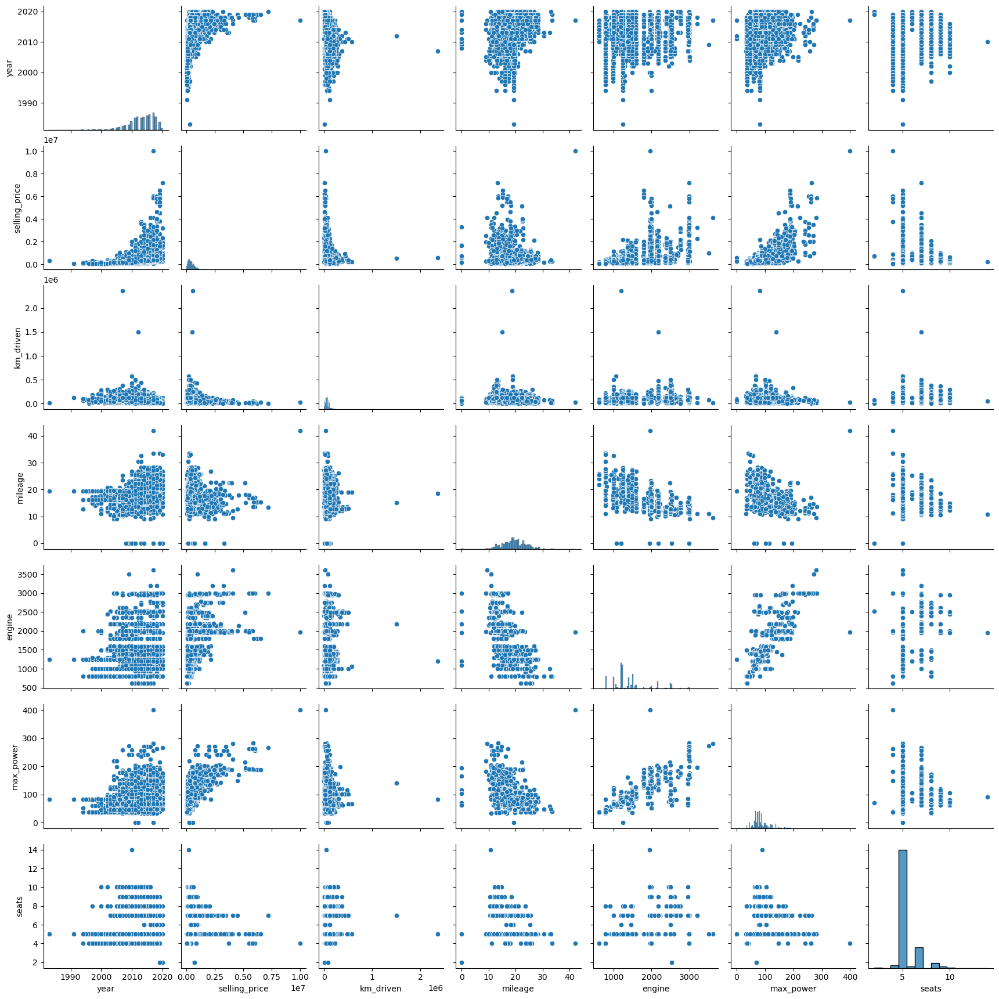

In [30]:
sns.pairplot(df_train)

Этот график не такой информативный, как можно было бы построить, беря признаки по отдельности. Но он позволяет сделать некоторые (возможно, далеко идущие) выводы. Впрочем, со многими из них (если не со всеми) вы бы справились умозрительно. Однако всегда приятно делать выводы, основываясь на данных.



* <font color='#FF6600'> Что можно сказать о связи предикторов с целевой переменной?
* А о корреляциях признаков? </font>

**Визуально, с ценой машины связаны следующие признаки:**     
**- max_power:** высокая мощность способствует повышению стоимости продажи = корреляция положительная   
**- engine:** машины с объемным двигетелем продаются дороже = корреляция положительная      
**- mileage:** автомобили с прожорливым двигателем продаются по более низкой цене (но связь не такая прямая, как с max_power)    
**- km_driven:** с ростом пробега цена снижается, причем размер дисконта увеличивается прогрессирующими темпами = корреляция отрицательная       
**- year:** относительно "свежие" автомобили продаются по более высокой цене = корреляция положительная        
**- seats:** с увеличением числа сидений стоимость машины уменьшается = корреляция отрицательная  

(0.25 балла) <font color='#9933CC'>Постройте pairplot по тестовым данным</font> и ответьте на вопрос <font color='#FF6600'>"Похожими ли оказались совокупности при разделении на трейн и тест?"</font>

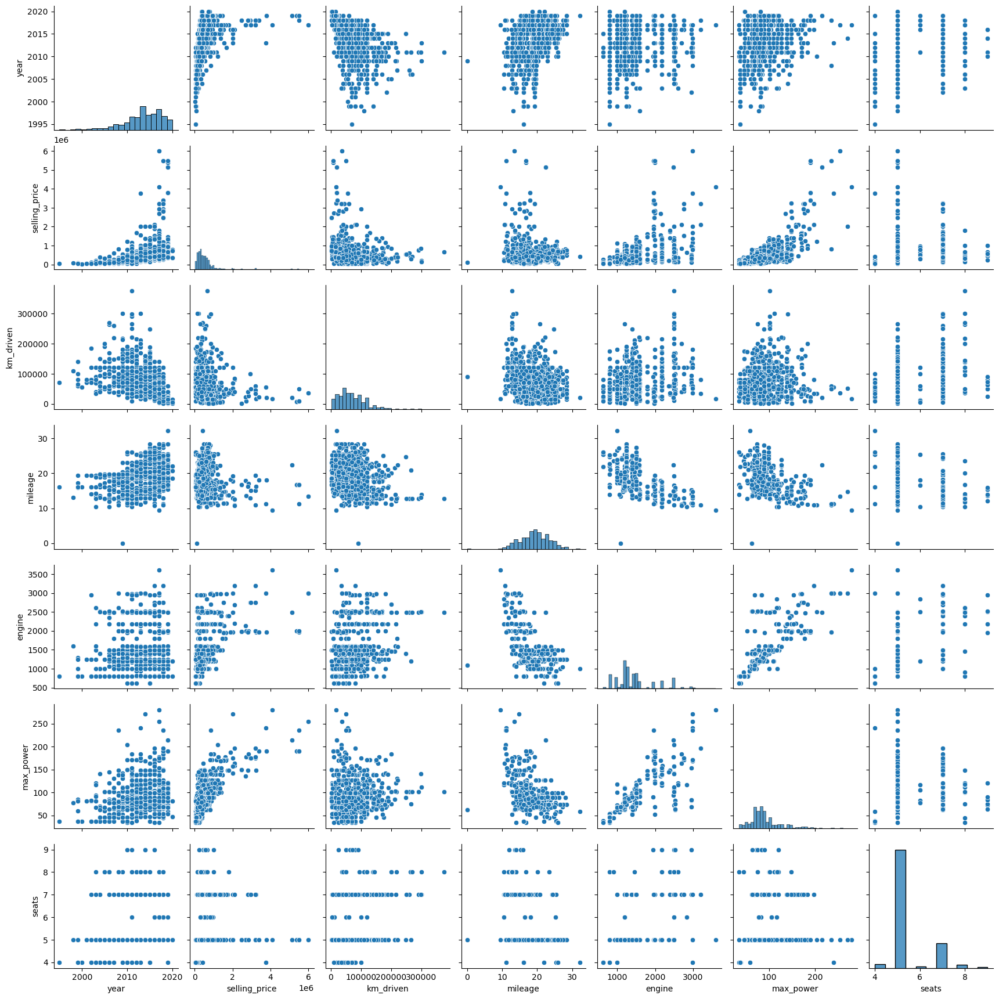

In [31]:
sns.pairplot(df_test)

**Ответ:**   

**Визуально,** в test и train одинаково распределена бОльшая часть количественных признаков - **max_power(мощность)**, **milege(расход)** и **km_driven(пробег)**.      


В то же время, по **year(год производства)** есть заметная разница - связь с ценой продажи стала гиперболической. В train'e связь имеет другой характер. 


(0.25 балла) <font color='#9933CC'>Для трейна давайте построим тепловую карту (heatmap из библиотеки seaborn) попарных корреляций числовых колонок</font>

<AxesSubplot:>

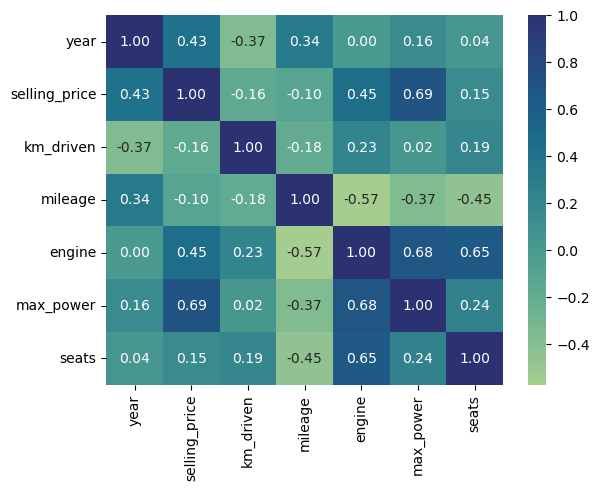

In [32]:
# применю маску на количественные признаки
df_train_mask = (df_train.dtypes != 'object').values # сделаю маску для всех чсловых переменных
for_heatmap = df_train[df_train.columns[df_train_mask]] # сделаю датасет по маске
sns.heatmap(for_heatmap.corr(method='pearson'), annot=True, fmt=".2f", cmap="crest")
# https://seaborn.pydata.org/generated/seaborn.heatmap.html
# https://www.pythonpool.com/matplotlib-cmap/

Ответьте, пожалуйста, на вопросы: 
* <font color='#FF6600'>Какие 2 признака наименее скоррелированы между собой?</font>      
* <font color='#FF6600'>Между какими наблюдается довольно сильная положительная линейная зависимость?</font>
* <font color='#FF6600'>Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи.</font>

Какие 2 признака наименее скоррелированы между собой?    
**Ответ:** year & engine (=0.00), km_driven & max_power (= 0.02)    

Между какими наблюдается довольно сильная положительная линейная зависимость?     
**Ответ:** max_power & selling_price (=0.69), max_power & engine (=0.68), seats & engine (=0.65)    


Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи.     
**Ответ:** да, поскольку корреляция отрицательная

(0.25 балла) <font color='#9933CC'> Отобразите диаграмму рассеяния для наиболее скореллированной пары **признаков** (на трейне) </font>

<AxesSubplot:xlabel='max_power', ylabel='selling_price'>

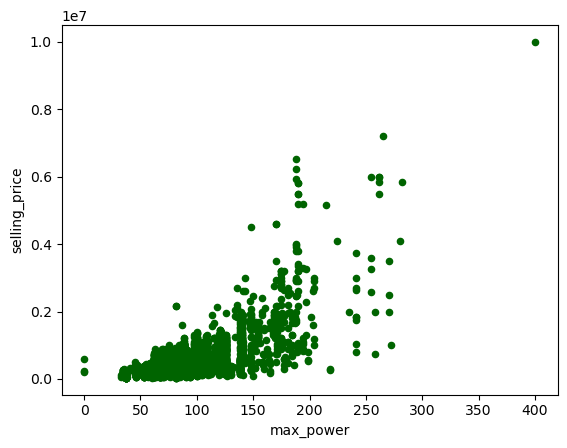

In [33]:
df_train.plot.scatter(x = 'max_power', y = 'selling_price', c = 'darkgreen')
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.plot.scatter.html

### Дополнительные визуализации (бонус 0.5 балла)

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их и поясните.

**Мы совершенно не изучили, как связаны друг с другом не количественные признаки:** для этого можно использовать алгоритм PPS Score, который может отыскивать не только линейные взаимосвзи, а также хорошо работает с номинальными и порядковыми признаками.    

Я вдохновлялся этими статьями: 
1. https://machinelearningknowledge.ai/predictive-power-score-vs-correlation-with-python-implementation/
2. https://towardsdatascience.com/rip-correlation-introducing-the-predictive-power-score-3d90808b9598     
3. https://github.com/8080labs/ppscore    

In [144]:
pip install -U ppscore

Note: you may need to restart the kernel to use updated packages.


In [145]:
import ppscore as pps

In [36]:
# удалю переменную torque из первоначального датасета (согласно заданию)
df_train_pps = df_train.drop('torque', axis = 1)

In [37]:
# Расчитаю матрицу попарных взаимодействий по PPS_Score
matrix_df = pps.matrix(df_train_pps)[['x', 'y', 'ppscore']].pivot(columns='x', index='y', values='ppscore')

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=4.
  warnings.warn(("The least populated 

In [38]:
# Посмотрим на матрицу попарных скоров по PPS_Score
matrix_df

x,engine,fuel,km_driven,max_power,mileage,name,owner,seats,seller_type,selling_price,transmission,year
y,,,,,,,,,,,,
engine,1.000000,3.818253e-02,0.000000,0.759419,0.725316,0.712328,0.000000,2.340407e-01,0.000000e+00,0.024673,0.000000e+00,0.000000e+00
fuel,0.875528,1.000000e+00,0.234649,0.814429,0.762138,0.787031,0.000000,1.171726e-01,0.000000e+00,0.187774,0.000000e+00,1.381575e-01
km_driven,0.112824,5.524951e-02,1.000000,0.118581,0.116130,0.076590,0.060466,1.709245e-02,4.964792e-03,0.000000,0.000000e+00,1.818697e-01
max_power,0.733222,0.000000e+00,0.000000,1.000000,0.640319,0.691996,0.000000,4.916157e-02,0.000000e+00,0.214732,3.544024e-02,0.000000e+00
mileage,0.449811,1.055578e-02,0.000000,0.639820,1.000000,0.685013,0.006984,1.497503e-01,0.000000e+00,0.012121,1.053551e-02,4.853815e-02
name,0.047881,7.829236e-06,0.000546,0.148263,0.192736,1.000000,0.000000,2.800762e-03,0.000000e+00,0.006334,0.000000e+00,1.629497e-03
owner,0.107097,3.206700e-04,0.131425,0.157296,0.134936,0.150773,1.000000,5.873788e-03,1.429422e-07,0.171270,1.429422e-07,2.414676e-01
seats,0.437802,0.000000e+00,0.000000,0.432533,0.586193,0.724247,0.000000,1.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
seller_type,0.052508,2.296133e-07,0.152693,0.132049,0.057185,0.083354,0.009465,2.296133e-07,1.000000e+00,0.121653,2.296133e-07,2.296133e-07


In [39]:
# Посмотрим, что влияет на предсказание таргета
matrix_df[9:10].T.sort_values(by = 'selling_price', ascending = False)

# https://proglib.io/p/kak-pravilno-sortirovat-dannye-v-pandas

y,selling_price
x,
selling_price,1.000000
max_power,0.468284
name,0.423824
mileage,0.327964
engine,0.301224
year,0.182383
owner,0.031902
transmission,0.005341
fuel,0.004882


<AxesSubplot:xlabel='x', ylabel='y'>

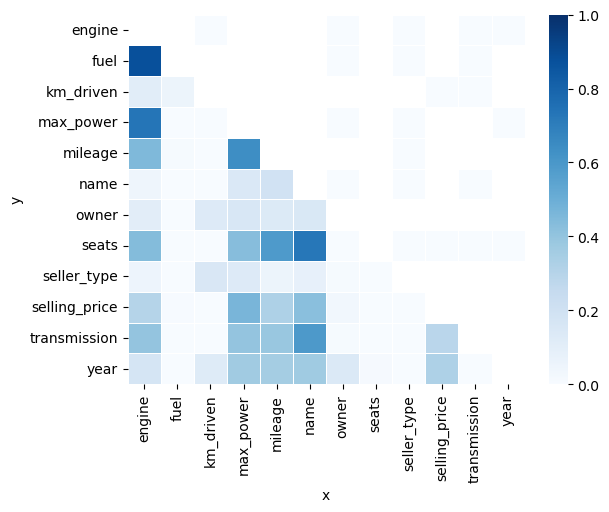

In [40]:
# Отрисую матриццу с PPS_Score

# Наложу маску на значения выше главной диагонали
matrix = np.triu(matrix_df)

# Отрисую матрицу корреляций по PPS
sns.heatmap(matrix_df,vmin=0, vmax=1, cmap="Blues", linewidths=0.5, annot=False, mask=matrix)

# https://pyprog.pro/array_creation/triu.html
# https://datastart.ru/blog/read/seaborn-heatmaps-13-sposobov-nastroit-vizualizaciyu-matricy-korrelyacii 

**Выводы:**
Как видно из матрицы PPS-Score, помимо количественных признаков на цену автомобиля влияет бренд/ модель: **name** -> возможно, его стоит включить в финальную модель (по результатам дальнейшего анализа).

# Часть 2 (1.25 балла) | Модель только на вещественных признаках

(0.05 балла) <font color='#9933CC'>В переменные ``y_train`` и ``y_test`` запишите значения целевых переменных. Столбцы ``selling_price`` из датафреймов необходимо удалить. Категориальные (все, кроме ``seats``) столбцы тоже.</font>

In [29]:
y_train = df_train['selling_price'] # выделю таргет

df_train_mask = (df_train.dtypes != 'object').values # сделаю маску для всех числовых переменных
X_train = df_train[df_train.columns[df_train_mask]] # наложу маску на датасет
X_train = X_train.drop('selling_price', axis = 1) # удаляю таргет
X_train

,year,km_driven,mileage,engine,max_power,seats
0,2014,145500,23.40,1248.0,74.00,5.0
1,2014,120000,21.14,1498.0,103.52,5.0
2,2010,127000,23.00,1396.0,90.00,5.0
3,2007,120000,16.10,1298.0,88.20,5.0
4,2017,45000,20.14,1197.0,81.86,5.0
...,...,...,...,...,...,...
5835,2008,191000,17.92,1086.0,62.10,5.0
5836,2013,50000,18.90,998.0,67.10,5.0
5837,2013,110000,18.50,1197.0,82.85,5.0
5838,2007,119000,16.80,1493.0,110.00,5.0


In [30]:
assert X_train.shape == (5840, 6)

In [31]:
y_test = df_test['selling_price'] # выделю таргет

df_test_mask = (df_test.dtypes != 'object').values # сделаю маску для всех числовых переменных
X_test = df_test[df_test.columns[df_test_mask]] # наложу маску на датасет
X_test = X_test.drop('selling_price', axis = 1) # удаляю таргет
X_test

,year,km_driven,mileage,engine,max_power,seats
0,2010,168000,14.00,2498.0,112.00,7.0
1,2017,25000,21.50,1497.0,108.50,5.0
2,2007,218463,12.90,1799.0,130.00,5.0
3,2015,173000,25.10,1498.0,98.60,5.0
4,2011,70000,16.50,1172.0,65.00,5.0
...,...,...,...,...,...,...
995,2008,100000,19.81,1086.0,68.05,5.0
996,2017,50000,18.60,1197.0,81.83,5.0
997,2009,40000,23.00,1396.0,90.00,5.0
998,2012,25000,20.36,1197.0,78.90,5.0


In [32]:
assert X_test.shape == (1000, 6)

(0.2 балла) <font color='#9933CC'>Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и MSE для трейна и для теста</font>

**Замечание:** $R^2$ и MSE для трейна и для теста выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [33]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE

model_base = LinearRegression()

model_base.fit(X_train, y_train) # обучу модель

prediction_train = model_base.predict(X_train) # сделаю предсказание на train
prediction_test = model_base.predict(X_test) # сделаю предсказание на test

prediction_train.shape, prediction_test.shape

r2_train = r2_score(y_train, prediction_train) # R2 train
r2_test = r2_score(y_test, prediction_test) # R2 test

mse_train = MSE(y_train, prediction_train) # MSE train
mse_test = MSE(y_test, prediction_test) # MSE test

print('R2 на train:', r2_train)
print('R2 на test:', r2_test)
print('MSE на train:', mse_train)
print('MSE на test:', mse_test)

# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.r2_score.html
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html

R2 на train: 0.5922591702157314
R2 на test: 0.5941419794788392
MSE на train: 116874153930.02864
MSE на test: 233298779730.45703


Запомните правило:

> Использую линейную модель -- стандартизирую фичи

(0.25 балла) <font color='#9933CC'>Воспользуемся им</font>


In [34]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler() # задам scaler
scaler.fit(X_train) # посчитаю среднее и дисперсию на train'e
X_train_scaled = scaler.transform(X_train) # стандартизую среднее и дисперсию на train'e по показателям train'а
X_train_scaled = pd.DataFrame(data = X_train_scaled, columns = list(X_train.columns)) # перевожу в Pandas

X_test_scaled = scaler.transform(X_test) # стандартизую среднее и дисперсию на test'e по показателям train'а
X_test_scaled = pd.DataFrame(data = X_test_scaled, columns = list(X_test.columns)) # перевожу в Pandas
X_test_scaled

# https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html

,year,km_driven,mileage,engine,max_power,seats
0,-0.837167,1.565740,-1.362605,2.200379,0.761548,1.601702
1,0.872122,-0.814974,0.519155,0.139102,0.650920,-0.434419
2,-1.569719,2.405866,-1.638596,0.760986,1.330489,-0.434419
3,0.383754,1.648982,1.422399,0.141162,0.338003,-0.434419
4,-0.592983,-0.065798,-0.735352,-0.530144,-0.724021,-0.434419
...,...,...,...,...,...,...
995,-1.325535,0.433652,0.095132,-0.707236,-0.627617,-0.434419
996,0.872122,-0.398765,-0.208459,-0.478663,-0.192061,-0.434419
997,-1.081351,-0.565249,0.895506,-0.068879,0.066175,-0.434419
998,-0.348799,-0.814974,0.233127,-0.478663,-0.284672,-0.434419


In [35]:
model = LinearRegression() # задам модель
model.fit(X_train_scaled, y_train) # обучу модель

prediction_train_scaled = model.predict(X_train_scaled) # сделаю предсказание на train
prediction_test_scaled = model.predict(X_test_scaled) # сделаю предсказание на test

r2_train_scaled = r2_score(y_train, prediction_train_scaled) # R2 train
r2_test_scaled = r2_score(y_test, prediction_test_scaled) # R2 test

mse_train_scaled = MSE(y_train, prediction_train_scaled) # MSE train
mse_test_scaled = MSE(y_test, prediction_test_scaled) # MSE test

print('R2 на train(scaled):', r2_train_scaled)
print('R2 на test(scaled):', r2_test_scaled)
print('MSE на train(scaled):', mse_train_scaled)
print('MSE на test(scaled):', mse_test_scaled)

print('После шкалирования признаков метрики качества не изменились (это и ожидалось)')

R2 на train(scaled): 0.5922591702157303
R2 на test(scaled): 0.5941419794788518
MSE на train(scaled): 116874153930.02892
MSE на test(scaled): 233298779730.44974
После шкалирования признаков метрики качества не изменились (это и ожидалось)


Не очень результативно.

Зато уже сейчас можем интерпретировать модель. <font color='#FF6600'>"Какой признак оказался наиболее информативным в предсказании цены?"</font>

In [36]:
sorted(list(zip(X_train_scaled.columns, model.coef_)), key=lambda x: x[1])
# https://pythonru.com/uroki/linear-regression-sklearn
# https://pythonru.com/uroki/funkcija-zip-dlja-nachinajushhih

[('km_driven', -44158.81852005274),
 ('seats', -23209.132485997343),
 ('mileage', 28833.925777516386),
 ('engine', 61178.49433684676),
 ('year', 152772.57084581477),
 ('max_power', 322807.3532592339)]

**Ответ:**
Самое сильное влияние на цену влияет max_power(мощность двигателя)

(0.25 балла) <font color='#9933CC'>Теперь попробуем Lasso-регрессию.</font> Здесь и дальше обучайте модели на нормализованных признаках

In [37]:
from sklearn.linear_model import Lasso
model_l1 = Lasso(alpha=1, max_iter=1000, random_state=1) # alpha = 1 - регуляризатор

model_l1.fit(X_train_scaled, y_train)

pred_l1_train = model_l1.predict(X_train_scaled) # сделаю предсказание на train
pred_l1_test = model_l1.predict(X_test_scaled) # сделаю предсказание на test

r2_l1_train = r2_score(y_train, pred_l1_train) # R2 train
r2_l1_test = r2_score(y_test, pred_l1_test) # R2 test

mse_l1_train = MSE(y_train, pred_l1_train) # MSE train
mse_l1_test = MSE(y_test, pred_l1_test) # MSE test

print('R2 на train(LASSO):', r2_l1_train)
print('R2 на test(LASSO):', r2_l1_test)
print('MSE на train(LASSO):', mse_l1_train)
print('MSE на test(LASSO):', mse_l1_test)

# https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html#sklearn.linear_model.Lasso

R2 на train(LASSO): 0.5922591701804456
R2 на test(LASSO): 0.5941408124026636
MSE на train(LASSO): 116874153940.1429
MSE на test(LASSO): 233299450599.1693


<font color='#FF6600'>Занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Почему же?</font>

In [38]:
sorted(list(zip(X_train_scaled.columns, model_l1.coef_)), key=lambda x: x[1])
# https://pythonru.com/uroki/linear-regression-sklearn
# https://pythonru.com/uroki/funkcija-zip-dlja-nachinajushhih

[('km_driven', -44157.68985794259),
 ('seats', -23206.255649080053),
 ('mileage', 28832.043395883895),
 ('engine', 61173.66240922118),
 ('year', 152772.39021419562),
 ('max_power', 322808.2369194696)]

**Ответ:**  
1. Веса не "занулились", поскольку они изначально далеки от нуля -> потенциала для обнуления нет.    
2. Иерархия важности признаков не изменились, так как при alpha = 1 Lasso практически не отличается от обычной регрессии. 

(0.25 балла) <font color='#9933CC'>Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии</font>

Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).

In [39]:
%%time

from sklearn.model_selection import GridSearchCV

model_gs = Lasso() # задаю модель
params = {'alpha': np.arange(1, 101001, 100),
         'fit_intercept': [False, True]} # буду перебирать alpha по сетке c шагом 100

gs = GridSearchCV(model_gs, params, cv = 10, n_jobs=-1, scoring = 'r2', verbose = 2)
gs.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 2020 candidates, totalling 20200 fits
[CV] END .......................alpha=1, fit_intercept=False; total time=   0.0s
[CV] END ........................alpha=1, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=101, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=101, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=101, fit_intercept=False; total time=   0.0s
[CV] END ......................alpha=101, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=301, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=301, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=401, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=401, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=401, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=401, f

[CV] END .....................alpha=5301, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=5301, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=5301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=5401, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=6201, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=6201, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=6201, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=6201, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=6201, fit_intercept=False; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END .....................alpha=6201, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=18101, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=18201, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=18201, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=18601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=17401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=17401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=17401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=17401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=17401, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=20601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=20601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=20601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=20601, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=20601, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=22301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=22301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=22301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=22301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=22301, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=22301, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=44401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=44401 fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=41001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=41001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=41001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=41001, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=39201, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=39201, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=39201, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=39201, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=39201, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=39201, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=39301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=39301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=39301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=39301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=39301, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=39301, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=40701, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=40701, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=40701, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=40701, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=48101, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=48101, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=48101, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=48101, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=57001, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=57001, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=57001, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=57001, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=57001, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=57101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=57101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=55201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=55201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=55201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=55201, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=55201, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=64401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=64401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=64401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=64401, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=64401, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=64401, fit_intercept=True; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=74901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=74901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=74901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=74901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=74901, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=75001, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=79501, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=79501, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=79601, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ....................alpha=77801, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=77801, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=77801, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=77801, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=77801, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=77801, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=77901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=77901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=77901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=77901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=77901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=77901, fit_intercept=False; total time=   0.0s
[CV] END ...................

[CV] END ...................alpha=87301, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=87301, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=87401, fit_intercept=False; total time=   0.0s
[CV] END ...................

GridSearchCV(cv=10, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': array([     1,    101,    201, ..., 100701, 100801, 100901]),
                         'fit_intercept': [False, True]},
             scoring='r2', verbose=2)

In [40]:
print('Лучший R2:', gs.best_score_)
print('Лучшие параметры:', gs.best_params_)
print('Лучший коэффициент регуляризации:', gs.best_estimator_)

Лучший R2: 0.5750274757490735
Лучшие параметры: {'alpha': 26601, 'fit_intercept': True}
Лучший коэффициент регуляризации: Lasso(alpha=26601)


<font color='#FF6600'>Сколько грид-сёрчу пришлось обучать моделей?</font>    
**Ответ:** Модель обучалась порядка 7 секунд, однако, при увеличении числа гиперпараметров/ признаков/ объема выборки реальное время подбора гиперпараметров через Gridsearch может быть довольно высоким.

<font color='#FF6600'>Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?</font>    
**Ответы:** 
1. **Оптимальный коэффициент регуляризации:** 26601   
2. **Занулились следующие признаки:** mileage(расход), engine(объем двигателя), seats(число мест в салоне)

In [41]:
# посмотрим на новые веса 
sorted(list(zip(X_train_scaled.columns, gs.best_estimator_.coef_)), key=lambda x: x[1])

[('km_driven', -15740.182922705193),
 ('mileage', 0.0),
 ('engine', 0.0),
 ('seats', -0.0),
 ('year', 145864.05539476787),
 ('max_power', 321829.03577099275)]

(0.25 балла) <font color='#9933CC'>Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html)-регрессии</font>

In [42]:
%%time

from sklearn.linear_model import ElasticNet
from sklearn.model_selection import GridSearchCV

model_gs2 = ElasticNet() # задаю модель
params = {'alpha': np.arange(1, 101001, 100),
         'l1_ratio': np.arange(0, 1, 0.05)} # буду перебирать alpha по сетке c шагом 100
                                            # а также пропорцию между l1/l2-регуляризацией 

gs = GridSearchCV(model_gs2, params, cv = 10, n_jobs=-1, scoring = 'r2', verbose = 2)
gs.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 20200 candidates, totalling 202000 fits
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=89601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=89701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=89701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=89701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=89701,

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407524205734900.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 510144862401422.75, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 500591762125066.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ....................alpha=91601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91701, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=91701, fit_intercept=True; total time=   0.0s
[CV] END ...................

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 751249434477861.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 794940265610968.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 797762775473610.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

=94901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=94901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=94901, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=94901, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=94901, fit_intercept=True;

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 738276746198399.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 751822691870509.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798187133468818.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

1, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=100601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=100601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=100601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=100601, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=100601, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=91001, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=91101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91101, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=91101, fit_intercept=False; tota

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 766939532028639.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759506845548176.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798506296655912.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

it_intercept=True; total time=   0.0s
[CV] END ....................alpha=98901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=98901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=98901, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=98901, fit_intercept=True; total time=   0.0s
[CV] END ...................alpha=99001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=99001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=99001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=99001, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=99301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=99301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=99301, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=99301, fit_intercept=True; total tim

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798630623492774.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623027125190914.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759778024354681.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ...................alpha=96001, fit_intercept=False; total time=   0.0s
[CV] END ....................alpha=98701, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=98701, fit_intercept=True; total time=   0.0s
[CV] END ....................alpha=98701, fit_intercept=True; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623085625491531.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798786196086491.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 781669993543326.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ............................alpha=401, l1_ratio=0.1; total time=   0.0s
[CV] END ............................alpha=401, l1_ratio=0.1; total time=   0.0s
[CV] END ............................alpha=401, l1_ratio=0.1; total time=   0.0s
[CV] END ............................alpha=401, l1_ratio=0.1; total time=   0.0s
[CV] END ............................alpha=401, l1_ratio=0.1; total time=   0.0s
[CV] END ............................alpha=401, l1_ratio=0.1; total time=   0.0s
[CV] END ............alpha=401, l1_ratio=0.1500000total time=   0.0s
[CV] END .............................alpha=1, l1_ratio=0.05; total time=   0.0s
[CV] END .............................alpha=1, l1_ratio=0.05; total time=   0.0s
[CV] END .............................alpha=1, l1_ratio=0.05; total time=   0.0s
[CV] END .............................alpha=1, l1_ratio=0.05; total time=   0.0s
[CV] END .............................alpha=1, l1_ratio=0.05; total time=   0.0s
[CV] END ..............alpha=1, l1_ratio

scent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739062304316944.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798234263616607.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767270385926176.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site

..................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=1901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........alpha=1901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=1901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=1901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=1901, l1_ratio=0.150

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732147318414945.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732158975321315.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 774829427699750.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

=   0.0s
[CV] END ............alpha=601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ............alpha=601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ............................alpha=601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732179701429842.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739122947688493.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760031039423118.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

ime=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=1701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........................alpha=1701, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=1701, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=1701, l1_ratio=0.9; total time=   0.0s
[CV] END .......

conda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739141146735213.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732205613961679.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760053202993449.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_

0.45; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.45; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.5; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 781941348935524.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739198713413777.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760065807586502.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

ime=   0.0s
[CV] END ...........alpha=2201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=2201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=2201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........................alpha=2201, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=2201, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=2201, l1_ratio=0.2; total time=   0.0s
0.75; total time=   0.0s
[CV] END ..........................alpha=1501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=1501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=1501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=1501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=1501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=1501, l1_ratio=0.75; total time

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798423912267846.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 781953263556956.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753369787239140.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

 ............alpha=2301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=2401, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................a

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753359004509920.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753379464847475.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753374753285717.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

1_ratio=0.5; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=2401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2401, l1_ratio=0.65; total time=   0

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623323627381114.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623333602323793.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732268205683799.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

15000000000000002; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=3001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=3001, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=3001, l1_ratio=0.25; total tim

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732283384215719.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782000679432284.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 774967102436631.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=2801, l1_ratio=0.65; total time=   0.0s
[CV] END ...........................alpha=3101, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=3101, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=3101, l1_ratio=0.9; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782009992231423.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623349890032257.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739239773350652.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=3701, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........................alpha=3801, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=3801, l1_ratio=0.0; total time=   0.0s
[CV] END ...............

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 774979954391542.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798480859806185.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753418860523766.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ............alpha=3301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ..........................alpha=3301, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=3301, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=3301, l1_ratio=0.75; total time=   0.0s
[CV] END .................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760142838205138.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767506746495192.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732309318525931.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

o=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=4601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=4601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=4601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=4601, l1_ratio=0.25; total time=   0.0s
[C

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799120181209950.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799126982850791.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760149291230829.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conver

0.05; total time=   0.0s
[CV] END ..........................alpha=3601, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=3601, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=3601, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=3601, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=3601, l1_ratio=0.05; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=3601, l1_ratio=0.1; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799131145775443.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767525939413296.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739269215504711.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

.......alpha=4601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=4601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=4601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=4601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=4601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=4601, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775013847658499.5, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798532404849572.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782043667186252.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

al time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782048620126143.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775021872034859.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753452731294690.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

io=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=5801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........................alpha=5801, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=5801, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=5801, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=5801, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=5801, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=5801, l1_ratio=0.4; tota

[CV] END ...........................alpha=5301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=5301, l1_ratio=0.45; total time=   0.0s
[CV] END ...........................alpha=5301, l1_ratio=0.5; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782055970729507.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775024765456266.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760173603608658.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.alpha=5901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=5901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=5901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=5901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=5901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=5901, l1_ratio=0.1; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ...........alpha=5901, l1_ratio=0.15000000000000002; t

152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739289512187240.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753461553329348.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799152721941094.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_desce

....alpha=6301, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=6301, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=6301, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=6301, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=6301, l1_ratio=0.9; total time=   0.0s
[CV] END ...........................alpha=6301, l1_ratio=0.9; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=6301, l1_ratio=0.9500000000000001

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623395135941815.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775032544203709.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623391371088776.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

total time=   0.0s
[CV] END ...........................alpha=6101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6101, l1_ratio=0.25; total time=   0.0s
[CV] END ...........alpha=6101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775040215382476.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767554541512913.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798562255875018.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

_ratio=0.55; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ............alpha=7101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ..........................alpha=7101, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=7101, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=7101, l1_ratio=0.65; total time=   0.0s
[CV] END ..........................alpha=7101, l1_ratio=0.65; total time=   0

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775039198693429.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767556528678593.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767557487612772.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conve

me=   0.0s
[CV] END ...........................alpha=6601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=6601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=6601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=6601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=6601, l1_ratio=0.2; total time=   0.0s
[CV] END ...........................alpha=6601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=6601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........................alpha=6601, l1_ratio=0.25; total time=   0.0s
[CV] END ........

[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=6801, l1_ratio=0.05; total time=   0.0s
[CV] END ...........................alpha=6801, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=6801, l1_ratio=0.1; total time=   0.0s
[CV] END ...........................alpha=6801, l1_ratio=0.1; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799170723201254.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798566326989927.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623405790424539.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798571784212282.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799173409082219.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775047553468010.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

 END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=7701, l1_ratio=0.45; total time=   0.0s
[CV] END ...........................alpha=7701, l1_ratio=0.5; total time=   0.0s
[CV] END ...........................alpha=7701, l1_ratio=0.5; total time=   0.0s
[CV] END .......................

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799175105456065.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799175927144933.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799177520229663.1, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstant

..alpha=8101, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8101, l1_ratio=0.8; total time=   0.0s
[CV] END ............alpha=8101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8101, l1_ratio=0.8500000000000001; total time=   0.0s
[CVND ...........................alpha=8501, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=8501, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=8501, l1_ratio=0.4; total time=   0.0s
[CV] END ...........................alpha=8501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=8501, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=8501, l1_ratio=0.45; tot

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782085091793739.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782083688449981.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775053001716545.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=8601, l1_ratio=0.8; total time=   0.0s
[CV] END ............alpha=8601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ............alpha=8601, l1_ratio=0.8500000000000001; total tim

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623413188046803.5, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739314784326831.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799181931948601.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

..alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...........alpha=9501, l1_ratio=0.350

aconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782088372818962.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623414169563987.5, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767572867742565.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/

1; total time=   0.0s
[CV] END ............alpha=9001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ............alpha=9001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] END ...........................alpha=9101, l1_ratio=0.0; total time=   0.0s
[CV] E

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767575272805246.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782090786769303.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798582799473394.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.......................alpha=9601, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=9601, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=9601, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=9601, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=9601, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=9601, l1_ratio=0.75; total time=   0.0s
[CV] END ...........................alpha=9601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=9601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=9601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=9601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=9601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alpha=9601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........................alph

e did not converge. You might want to increase the number of iterations. Duality gap: 732375931580907.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799188253087746.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782091363560575.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number

..alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=10001, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=10001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=10001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=10001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=10001, l1_ratio=0.9500000000000001;

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782094620783154.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798586965253017.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767578043912617.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

0000000001; total time=   0.0s
[CV] END ...........alpha=10201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=10201, l1_ratio=0.75; total time=   0.

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767579593880592.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753497845354265.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798588600594818.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conv

, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=10101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=10101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=10101, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=10101, l1_ratio=0.7000000000000001; total time=

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767582009180328.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753500859124032.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760211370374456.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=11001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=11001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=11001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=11001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=11001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=11001, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=11001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=11001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=11001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=11001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=11001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=11001, l1_ratio=0.8500000000000001; total time=   0

[CV] END ..........................alpha=11501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=11501, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=11501, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=11

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739324894686366.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799193554920194.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753501332605459.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

0s
[CV] END ...........alpha=12401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=12401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=11101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11101, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=11101, l1_ratio=0.25; total time=   0.0s
[CV] END ................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775070078410222.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799195897657734.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760215633584120.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

ND ..........alpha=11901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=11901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=11901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=11901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=11901, l1_ratio=0.2; total time=   0.0s
[CV] END .........................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760216789413036.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798594828293105.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782101078326870.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=12401, l1_ratio=0.25; total time= 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798596095159822.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798595679172402.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623424595155814.5, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

 ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=12401, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=12401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=12401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=12401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=12401, l1_

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798597699267411.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739331249700764.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732389362977382.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=12701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=12701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=12701, l1_ratio=0.65; total time=   0.0s
[CV] END ......................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753510420534415.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782106641672364.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732392031401900.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

otal time=   0.0s
[CV] END ...........alpha=13301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=13301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=13301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=13301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=13301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=13301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14001, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=14001, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=14001, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=14001, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=14001, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=14001, l1_ratio=0.05; total time=   0.0s
[CV] END .

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782106972742535.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798600991542220.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799204362886766.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

al time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=13401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=13401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=13401, l[CV] END .........................alpha=13401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=13401, l1_ratio=0.2

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760222477465865.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782108253754065.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753512027455031.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=13801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=13801, l1_ratio=0.25; total time=   0.0s
[CV] END ....................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799205643889221.1, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623430225268883.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623429991533982.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

al time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=13701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798604805196004.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732394989392688.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753514940051812.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

3; total time=   0.0s
[CV] END ..........................alpha=14301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=14301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=14301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=14301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=14301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=14301, l1_ratio=0.4; total time=   0.0s
[CV] END ......................alpha=13801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=13801, l1_ratio=0.1; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799207733452132.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623431131178137.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739337018889468.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

...........alpha=14301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=14301, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=14301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=14301, l1_r

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767596775524936.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753516005653121.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732397100768370.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ..........................alpha=15201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=15201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=15201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=15201, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767597525368956.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782111724194578.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799209385935865.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

ND ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=15301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=15301, l1

 to increase the number of iterations. Duality gap: 623433013629886.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775082415201037.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798607310081511.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782

.......alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=15401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=15501, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=15501, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=15501, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782114489768611.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767598947942437.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753517750517174.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

...............alpha=16601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=16901, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=16901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=16901, l

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775084786395947.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799211654633445.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739341318870110.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

a=16501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=16501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=16501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=16501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=16501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=16501, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=16501, l1_ratio=0.9500000000000001; total

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760230129599975.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732400131535313.4, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767599843350737.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

...alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.1s
[CV] END ..........................alpha=16301, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=16301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=16301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=16301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=16301, l1_ratio=0.05

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782116507927570.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798610716923373.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798610490956663.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760231320758302.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760231511971632.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782116720113378.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=17301, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=17301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=17301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=17301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=173

da3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732401387482866.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775087302407247.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782117946819412.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_co

ND ...........alpha=17901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=17901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=17901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=17901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=17901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=17901, l1_ratio=0.9; total time=   0.0s
[CV] END .........................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775088628548443.5, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767602872324153.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760232618283149.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

..................alpha=18401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=18401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=18401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=18401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=18401, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=18401, l1_ratio=0.

[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=18001, l1_ratio=0.9500000000000001; t[CV] END ..........................alpha=18201, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=18201, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=18201, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=18201, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=18201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=18201,

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739344635226883.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760232796117568.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739343951161678.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

......alpha=18701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=18701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=18701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=18701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=18701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=18701, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=18701, l1_ratio=0.700000000000

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799216711372400.1, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760233826335802.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775089168481349.5, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799217259817051.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739345611277950.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775089519528075.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=19401, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=19401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=19401, l1_ratio=0.55; total time=   0.0s
[CV] END ...................

ant to increase the number of iterations. Duality gap: 753524363628533.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753524530793797.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760234479973090.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7

.................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=19001, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=19001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=19001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=19001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=19001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=19001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=19001, l1_ratio=0.85

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799218646460794.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760235108831193.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798616004654257.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

a=19901, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=19901, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=19901, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=19901, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=19901, l1_ra

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798616174511139.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767606096672846.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767606250517418.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20101, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=20101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=20101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=20101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=20101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=20101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623440428638575.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775091946145038.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775091794854593.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=20301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=20301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=20301, l1_ratio

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798617633745126.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732407639250403.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775092967360289.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

003; total time=   0.0s
[CV] END ..........alpha=20801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=20801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=20801, l1_ratio=0.4; total time=   0.0s
[CV]

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623441580506417.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732408462709913.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767607852563377.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

0001; total time=   0.0s
[CV] END ...........alpha=21301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=21301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=21301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=21301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=21301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=21301, l1_ratio=0.9; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775093385746015.5, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623441690160887.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760237797235758.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=21801, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=21801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=21801, l1_ratio=0.65; total time=   0

er of iterations. Duality gap: 753528369144019.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760238181645358.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623442328492214.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760238054613317.4, tolera

.....................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=22301, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=22301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=22301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=22

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798619680579957.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799222509330375.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760238679054777.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag


[CV] END ..........................alpha=22901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=22901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=22901, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=22901, l1_ratio=0.05; total time=   0.0s
[CV] END ..................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782125552656828.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739349863672976.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739350216659014.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

ND ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=23001, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=23001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=23001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=23001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767610513212399.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753529981601227.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782126414885280.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

; total time=   0.0s
[CV] END ..........alpha=23401, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=23401, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=23401, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=23401, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=23401, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23401, l1_ratio=0.2; total time=   0.0s
[CV] EN

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760239625153333.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732410577731690.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739351116039783.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

6000000000000001; total time=   0.0s
[CV] END ...........alpha=22701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=22701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=22701, l1_ratio=0.65; total time

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798621496346964.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799224140695475.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760240075407606.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

total time=   0.0s
[CV] END ..........alpha=23501, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=23501, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=23501, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=23501, l1_ratio=0.2; total time=   0.0s
[CV] END 

[CV] END ..........................alpha=24201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=24201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=24201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=24201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=24201, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=24201, l1_ratio=0.55; total time=   0.0s
[CV] END ...................

ages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767611411081883.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753530891201737.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753531000857586.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Co

l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=24701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=24701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=24701, l1_ratio=0.75;

 cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798622897098491.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623444922310343.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732412007781702.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt

.........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25201, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=25201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25201, l1_ra

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732412620487441.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623445167834928.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782128629302534.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

me=   0.0s
[CV] END ..........................alpha=25101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=25101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=25101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=25101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=25101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=25101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=25101, l1_rati] END ...........alpha=24901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=24901, l1_ratio=0.7000000000000001; 

[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=25501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=25501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=25501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=25501, l1_ratio=0.8; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767612950659217.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767613047216052.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753532449802417.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

o=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=25401, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=25401, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25401, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=25401, l1_ratio=0.30000000000000004; total time=   0.0s
[

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775098457946985.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739353585652003.4, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798624072156074.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26101, l1_ratio=0.35000000000000003; total 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775099024774356.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782129424891528.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775098649657544.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=26501, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=26501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=26501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=26501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=26501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=26501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767613885083303.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799227041451117.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798624476145218.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=27301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=27301, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=27301, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=27301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=27301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=27301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=27301, l1_ratio=0.55; total time=   0.0s
[CV] END ..........................alpha=25601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=25601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=25601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=25601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=25601, l1_ratio=0.2; total time= 

s/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799227234069672.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623446460825107.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799227329350841.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conver

.alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=27901, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=27901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=27901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=27901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=27901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=27901, l1_ratio=0.1;

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799227795763138.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623446389081796.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782130356574342.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775099743422309.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767614670588907.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753534017203732.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=26701, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=26701, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=26701, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=26701, l1_ratio=0.4; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767614754847584.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799228067864633.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739355100145767.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

[CV] END ..........alpha=27801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=27801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782131225098270.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753534773377333.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739355256898125.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

........alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=28101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=28101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=28101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=28101, l1_ratio=0.150000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775100505156939.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782131308723349.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753534935150666.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

CV] END .........................alpha=28501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=28501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=28501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=28501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=28501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=28501, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=28501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=28501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=28501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=28501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=28501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=28501, l1_ratio=0.5; total time=   0.0s
[CV] END ....................

d_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753535094745439.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753535015217613.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775100908529981.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/a

..............alpha=27601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=27601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=27601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=27601, l1_ratio=0.300000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799229102036193.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739355863009187.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775101144143176.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=29601, l1_ratio=0.350

5101066127240.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798626757023667.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739356154103098.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782131878644878.4, tolerance: 156431196096.9986
  model = 

.........alpha=29701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=29701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=29701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=29701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=29701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alp

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767616027851109.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732416313032227.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782132192646460.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

0003; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.4; total time=   0.0s
, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=30101, l1_ratio=0.6000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732416532550629.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753535861531017.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775101750152465.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

; total time=   0.0s
[CV] END ..........................alpha=29401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29401, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=29401, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=29401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=29401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=29401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=29401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=29401, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=29401, l1_ratio=0.25; total time=   0.0s
[CV] EN

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732416604785402.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623448458233908.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775101969420122.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

........alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=30001, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=30001, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=30001, l1_rat

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732416747874792.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767616828268727.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760246059485537.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732417302458835.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623448966319636.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623448855873649.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

  0.0s
[CV] END ..........................alpha=31601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=31601, l1_ratio=0.25; total time=   0.0s
0.9; total time=   0.0s
[CV] END ..........................alpha=30401, l1_ratio=0.9; total time=   0.

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767617509051794.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799231012049560.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739357689702030.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=31001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=31001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=31001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=31001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=31001, l1_ratio=0.4; total time=   0.0s
[

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767617640227491.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799231221746317.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739357813086549.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

CV] END ..........................alpha=31501, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=31501, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=31501, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=31501, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=31501, l1_ratio=0.05; total time=   0.0s
[CV] END ....................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753537319605596.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760246907639880.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782133850444736.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=31801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=31801, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=31801, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=31801, l1_ratio=0.75; total tim

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799231696477697.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753537576422577.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760247155368266.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=32201, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=32201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=32201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=32201, l1_ratio=0.8; total time=   0.0s
[CV] END ........................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767618394876205.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732418515315170.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798629577809234.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

 ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=32701, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=32701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=32701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=32701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................al

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782134626873210.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798629643501275.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623449902038361.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=32601, l1_ratio=0.25; total time=   0.0s
[CV] END ...........alpha=33201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=33201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=33201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=33201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760247864288270.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732418753632200.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623450144683581.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

0.0s
[CV] END ..........................alpha=33501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33501, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=33501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=33501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=33501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=33501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=33501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=33501, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alp

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767618869063916.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775104130430978.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753538486757949.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

total time=   0.0s
[CV] END ..........................alpha=34101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=34101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=34101, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=34101, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=33301, l1_ratio=0.8; total time=   0.0s
[CV] END 

ant to increase the number of iterations. Duality gap: 732418986486821.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623450380416382.5, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753538659462329.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 

0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=33801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=33801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=33801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=33801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=33801, l1_ratio=0.65; total time=   0.0s
[CV] END ................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753538716374462.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739359395322909.9, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623450609527994.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=34601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=34601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=34601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=34601, l1_ratio=0.25; total time=   0.0

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623450743931869.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798630703804844.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623450654580254.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

3601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=33601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=33601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=33601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=33601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=33601, l1_rati

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732419545923462.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782135750659530.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799233067638749.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

a=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=35501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=35501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=35501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=35501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=35501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=35501, l1_r

ant to increase the number of iterations. Duality gap: 798630938735997.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767619648464718.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775105090350912.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775105144024738.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775105250492557.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798631168504231.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

[CV] END ...........alpha=35001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=35001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=35001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=35801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=358

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782136081366903.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753539532739897.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767619964341260.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

....alpha=35801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=35801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=35801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=35801, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=35801, l1_ratio=0.5

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782136609155401.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739360287713498.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782136453782146.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

1; total time=   0.0s
[CV] END ..........................alpha=35601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=35601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=35601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=35601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=35601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=35601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=35601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=35601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=35601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=35601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=35601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=35601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] E

[CV] END ...........alpha=36001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=36001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=36001, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=36

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739360334785705.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623451545617903.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798631721424071.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

time=   0.0s
[CV] END .........................alpha=36901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=36901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=36901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=36901, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=36901, l1_ratio=0.5; total time=   0.0s
[CV] END ......

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798631986943124.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798631934401216.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782136762075576.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760249724528554.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798632245548130.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767620805862109.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

pha=37201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=37201, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=37201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=37201, l1_ratio=0.65; to

[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=36601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=36601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=36601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=36601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=36601, l1_ratio=0.25; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799234785924877.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767620993178568.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798632397503864.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

tal time=   0.0s
[CV] END ..........alpha=37801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=37801, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=37801, l1_ratio=0.25; total time=   0.0s
[CV] END ..

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739361055280996.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799234932668854.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732421189568683.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conve

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767621356488363.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767621311877350.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782137677173107.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

END ..........................alpha=38601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=38601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=38601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=38601, l

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623452414442622.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782137813755384.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775106897561159.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

=38201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=38201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=38201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=38201, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=38201, l1_ratio=0.9500000000000001; total 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799235406037626.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739361558203562.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623452590292599.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

ND ..........alpha=39601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=39601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=39601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=39601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=39601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=39601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=39601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=39601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=39601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=39601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=39601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=39601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798633353298223.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623452659425860.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775107159585934.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

atio=0.8; total time=   0.0s
[CV] END ..........................alpha=38801, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=38801, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=38801, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=38801, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=38801, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=38801, l1_ratio=0.8500000000000001; total time=   0.0s

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798633443736824.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623452727884695.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798633398628347.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

.8; total time=   0.0s
[CV] END ..........................alpha=39501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=39501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=39501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=39501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=39501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=39501, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=39501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=39501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=39501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=39501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=39501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=39501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] 

nt to increase the number of iterations. Duality gap: 798633488625274.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798633621986448.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799235812423763.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 77

alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=39901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=40001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=40001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=40001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=40001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=40001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=40001, 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753541828796543.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799236073626354.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739362108453016.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

=40101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=40101, l1_ratio=0.350000000

[CV] END ...........alpha=40201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=40201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=40201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=40201, l1_ratio=0.9; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775107701564124.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760251342994802.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799236285635139.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=41101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=41201, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=41201, l1_ratio=0.0; total time=   0

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623453283893977.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739362369984237.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782138756305883.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

5; total time=   0.0s
[CV] END .........................alpha=41301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=41301, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=41301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.1; total time=   0.0s
[CV] E

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739362333151301.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782138837165209.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623453377449871.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753542376011861.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782139075251295.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753542338109424.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

 time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=42101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.2; total time=   0.0s
[CV] END .....

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767622862581864.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623453469709461.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799236814102546.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag


[CV] END ..........................alpha=41601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=41601, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=41601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=41601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=41601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=41601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=41601, l1....alpha=41901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=41901, l1_ratio=0.9; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739362868027059.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753542488668829.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760251976131667.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

] END ..........................alpha=42101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=42101, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=42101

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782139420233955.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782139457698191.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753542745561236.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

42201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=42201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=42201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=42201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=42201, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=42201, l1_ratio=0.8500000000000001; total t

 increase the number of iterations. Duality gap: 623453797328650.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732423176360963.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760252257378419.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7324232

....................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=43601, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=43601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=43601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=43601, l1_ratio=

[CV] END ..........alpha=43301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=43301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=43301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=43301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=43301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=44201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=44201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=44201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=44201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=44201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=44201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=44201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=442

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799237237259945.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775108797253100.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739363138616874.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

..........................alpha=43301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=43301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=43301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=43301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=43301, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=43301, l1_r

[CV] END ..........................alpha=43801, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=43801, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=43801, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=43801, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=43801, l1_ratio=0.9; total time=   0.0s
[CV] END .........................alpha=44201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=44201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=44201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=44201, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=44201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=44201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=44201, l1_ratio=0.8; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623454164182571.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623454136705613.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732423631489685.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

  0.0s
[CV] END .........................alpha=44501, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=44501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=45201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=45201, l1_ratio=0.35000000000000003; total time=   0.0s
=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=44301, l1_ratio=0.15000000000000002;

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775109074988235.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760252854726826.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739363589552354.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ..........alpha=45201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=45201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45201, l1_ratio=0.4; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623454379743999.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753543567493974.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739363744034782.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

.......................alpha=45501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=45501, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623454432480455.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798635694920946.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782140342162156.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ..........................alpha=45001, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=45001, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ...................

ges/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782140274904640.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753543632167025.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760252949808246.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conv

.......alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=45101, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=45101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=45101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=45101, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=45101, l1_ratio=

[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=46001, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=46001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46001, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623454714643026.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732424314075353.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782140669990170.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

pha=45801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=45801, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=45801, l1_ratio=0.5; to

ges/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760253258109091.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798635967551951.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767624319368327.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conv

ime=   0.0s
[CV] END ..........................alpha=46601, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=46601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=46601, l1_ratio=0.9; total time=   0.0s
[CV] END .......

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739364302020613.4, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739364188213027.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623454863144375.5, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

6701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=46701, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=46701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=46701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=46701, l1_ratio=0.5; total t

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767624502020193.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798636295667489.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799238487386117.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

........alpha=46901, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=46901, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=46901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=46901, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=47601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47601, l1_ratio=0.7000000000000001; .....alpha=47701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=47701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47701, l1_ratio=0.75; total time= 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767624680190060.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799238646427943.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775110065030566.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ...........alpha=47501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=47501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END ...................

ages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782141106516829.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782141076163543.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753544308585547.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Con

......alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=47501, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=47501, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=47501, l1_ratio=0.850000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798636671942919.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753544511201255.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753544539679526.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

....alpha=48001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=48001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=48001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=48001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=48001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=48001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=48001, l1_ratio=0.1500000000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782141461343050.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799238985101613.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760253975126488.9, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

..alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=48601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=48101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=48101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=48101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=48101, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=48101, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=48101, l1_ratio=0.6000000000000001;

ages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753544708166642.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798636883146361.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782141490149256.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Co

=49501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=49501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=49501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=49501, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=49501, l1_ratio=0.55; total 

[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=49101, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=49101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=49101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=49101, l1_ratio=0.5; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739364895864528.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623455466275597.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623455444217539.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

alpha=50201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50201,

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799239337935303.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753544872673970.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739365023712172.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

1; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=49201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=49201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=49201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=49201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=49201, l1_ratio=0.9; total time=   0.0s
[CV] E

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623455596828618.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732425407183367.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739365074154821.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

...................alpha=50401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50401, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=50401, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=5040

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782141908922281.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767625404288828.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775110883511033.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799239591874361.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753545164392381.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767625561125770.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=51301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] EN

[CV] END ..........................alpha=50801, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=50801, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=50801, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=50801, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=50801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=51501, l1_ratio=0.1; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782141989788953.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760254524449636.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753545216108716.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775111144820651.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782142122520885.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799239729189756.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=50501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=50501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=50501, l1_ratio=0.4; total time=   0.0s
[CV]

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799239837173230.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623455930573940.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623455889957706.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

2301, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.45; total time=   0.0s
[CV] END .[CV] END .........................alpha=51001, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=51001, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=51001, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=51001, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=51001, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=51001, l1_ratio=0.7

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767625789723359.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799239943536024.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798637618682227.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

..................alpha=52301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=52301, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=52301, l1_ratio=0.

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767626010687285.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760254866797516.9, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799240100120367.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

al time=   0.0s
[CV] END ..........................alpha=52901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=52901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=52901, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=52901, l1_ratio=0.45; total time=   0.0s
[CV] END ...

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760254890569185.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798637882686746.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760254984778721.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

D ..........................alpha=52601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=52601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=52601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................

[CV] END ...........alpha=53101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=53101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=53101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53101, l1_ratio=0.9; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775111590969647.5, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798638011049428.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623456206556469.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

.alpha=53501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=53501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=53501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=53501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=53501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=53501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=53501, l1_ratio=0.9; total time=   0.0s
ND ...........alpha=53001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=53001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=53001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=53001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=53001, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=53001, l1_ratio=0.600000000

5111614891646.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732426279881471.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760255100603157.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753545830597046.0, tolerance: 150711727445.57935
  model =

.......................alpha=54001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=54001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=54001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=54001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=54001, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=54001, l1_ratio

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782142750113937.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767626270934185.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760255236827914.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

D ..........................alpha=53601, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=53601, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=53601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................

s/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753546015520918.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799240573756388.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760255326014042.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conver

=0.4; total time=   0.0s
[CV] END ..........................alpha=53901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=53901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=53901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=54501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=54501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=54501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=54501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=54501, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=54501, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=54501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=54501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=54501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732426531589001.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623456486967288.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760255435711481.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799240740224298.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753546173003096.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799240716696146.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ..........................alpha=55101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55101, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55101, l1_ratio=0.25; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767626653273195.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623456559229031.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782143077350591.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55501, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775112030956692.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760255522074057.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739366281226214.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

......alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=55501, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=55501, l1_ratio=0.3000000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623456718135807.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775112207454829.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775112185663489.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

002; total time=   0.0s
[CV] END ..........alpha=55901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=55901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=55901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=55901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=55901, l1_ratio=0.2; total time=   0.0s
[CV]

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753546455280015.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732426901682634.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623456770003179.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

s
[CV] END ...........alpha=56401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=56401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=56401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=56401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=56401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=56401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=56401, l1_ratio=0.9500.alpha=56201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=56201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=56201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=56201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=56201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=56201, l1_ratio=0.5; total time=   0.0s
[CV] END ...

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739366504012094.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798638688411480.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775112336616751.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

0000004; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=57301, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=57301, l1_ratio=0.4; total time=   0.0s


[CV] END ..........................alpha=56001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=56001, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=56001, l1_ratio=0.45; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767626972083142.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753546560473053.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799241127833007.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

01, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=57401, l1_ratio=0.35000000000000003; total time=   0.[CV] END ..........alpha=56401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=56401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=56401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=56401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=56401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=56401, l1_ratio=0.3500000000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767627095052909.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760255995896293.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753546725054640.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=58101, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=58101, l1_ratio=0.30000000000000004; total time= 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256132844670.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767627235383259.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623457134489824.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

END .........................alpha=58901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=58901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=58901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=58901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=58901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=58901, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=58901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=58901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=58901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=58901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=58901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=58901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=58901, 

[CV] END .........................alpha=58301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=58301, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=58301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=583

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753546885210713.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256171383920.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782143828745710.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

ND .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=58101, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=58101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=58101, l1_ratio=0.5; total time=   0.0s
[CV] END .........................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775112807807737.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739366980116291.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256247694233.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

01, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=57401, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=57401, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=57401, l1_ratio=0.6000000000000001; total time

2143889099206.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798639364974614.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739366961831324.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782143929002909.5, tolerance: 156431196096.9986
  model = c

...........alpha=59401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=59401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=59401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=59401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=59401, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=59401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=59401, l1_ratio=0.7D ..........................alpha=59401, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=59401, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=59401, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=59401, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=59401, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=59401, l1_ratio=0.0; tota

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799241698971054.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753547117529734.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799241779305332.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

me=   0.0s
[CV] END .........................alpha=60401, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=60401, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=60401, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ........

ant to increase the number of iterations. Duality gap: 798639487966915.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753547174181365.4, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798639568624246.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 

000000000000003; total time=   0.0s
[CV] END ..........alpha=60501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=60501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=60501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=60501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=60501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=60501, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=60501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=60501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=60501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=60501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=60501, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=60501, l1_ratio=0.4; total time=

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256525046131.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144124634876.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767627655692926.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

0.25; total time=   0.0s
[CV] END .........................alpha=60601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=60601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=60601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775113152102473.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256614524208.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767627710696897.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=60901, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=60901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=60901, l1_ratio=0.9; total time=   

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798639707270407.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732427801686093.4, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144220088262.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

al time=   0.0s
[CV] END ..........................alpha=60701, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=60701, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=60701, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=60701, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=60701, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=60701, l1_ratio=0.0; total time=   0.0s
[CV] END .........................................alpha=61401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=61401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=61401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=61401, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=61401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=61401, l1_ratio=0.6000000000000001; total time=   0

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739367435119271.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256702575265.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732427855780423.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

V] END ..........alpha=61201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=61201, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=61201, l1_ratio=0.25; total time=   0.0s
[CV] END .....................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144443024217.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739367451869414.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798639918928163.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

...alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=62501, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=62501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=62501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=62501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=62501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=62501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=62501, l1_ratio=0.

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798639937804447.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144479361059.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798639956621092.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

ime=   0.0s
[CV] END .........................alpha=62701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62701, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=62701, l1_ratio=0.8; total time=   0.0s
[CV] END .......

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144497443784.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428014991949.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767628029858345.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.........alpha=61501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=61501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=61501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=61501, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=61501, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=61501, l1_ra

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753547694390535.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767628098352773.5, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799242313573379.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.7000000000000001; total time=   0.0s
[CV] END ...........alpha=62201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=62201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=62201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=62201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=62201, l1_ratio=0.75; total tim

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760256975136821.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798640177870034.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739367680909648.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conve

ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=63201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=63301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=63301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=63301, l1_ratio=0.0; to

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428220373475.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798640213946983.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623457857356377.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

63101, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=63101, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=63101, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=63101, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=63101, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=63101, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=63101, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=63101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=63101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=63101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=63101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=63101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=63101, l1_ratio=0.8; total 

[CV] END ..........................alpha=63601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=63601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=63601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=636

nt to increase the number of iterations. Duality gap: 799242439926437.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144744760072.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760257106393638.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7751

.alpha=64101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=64101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=64101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=64101, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=64101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=64101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=64101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=64101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=64101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=64101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=64801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=64801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=64801, l1_ratio=0.2; 

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799242510910109.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739367822963920.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428353107489.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conve

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760257218625309.9, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798640373571102.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775113800395365.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

 total time=   0.0s
[CV] END .........................alpha=64601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=64601, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=64601, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739367915511256.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428450546411.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458044235525.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

ha=64501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=64501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=64501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=64501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=64501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=64501, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=64501, l1_ratio=0.30000000000000004; tot

[CV] END ..........................alpha=65201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=65201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=65201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=65201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=65201, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=65201, l1_ratio=0.25; total time=   0.0s
[CV] END ...................

8482633566.4, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739367976278927.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782144998186704.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458070289272.4, tolerance: 124693338888.66301
  model = cd_

ha=64701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=64701, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=64701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=64701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=64701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=64701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=64701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=64701, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=65301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=65301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=65301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=65301, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=65401, l1_ratio=0.0; tota

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428546229753.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782145047506317.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799242769516614.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

e=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=66001, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=66001, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66001, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END .........

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753548231739433.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114058595838.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458198238776.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

ND ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=65701, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=65701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=65701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=65701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=65701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=65701, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=65701, l1

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799242886260604.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458223374438.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799242935554733.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=66301, l1_ratio=0.35000000000000003; total 

e did not converge. You might want to increase the number of iterations. Duality gap: 623458260800301.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767628632458377.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753548308586216.9, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the numbe

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760257571142192.9, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799242984413931.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767628724007342.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

l time=   0.0s
[CV] END ...........alpha=66301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=66301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=66301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=66301, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=66301, l1_ratio=0.65; total time=   0.0s
[CV] END ....

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753548399317239.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458371119639.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458297896917.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

............alpha=66701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=66701, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=66701, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=66701, l1_r

[CV] END ..........................alpha=67201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=67201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=67201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=67201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=67201, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=67201, l1_ratio=0.45; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428793154847.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114319775723.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799243064894936.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114334737893.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798640939017311.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114394154781.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

[CV] END ..........................alpha=68001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=68001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=68001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=68001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=68001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=68001, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=68001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=68001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=68001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=68001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=68001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=68001, l1_ratio=0.45; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732428941684811.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753548517841028.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767628916933152.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=68401, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=68401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=68401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=68401, l1_ratio=0.8; total time=   0.0s
[CV] END 

 did not converge. You might want to increase the number of iterations. Duality gap: 739368464644632.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429014351617.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641033067421.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629032105309.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429043127267.4, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114467468279.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=68801, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=68801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=68801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=68801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=68801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alp

[CV] END .........................alpha=68901, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=68901, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=689

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739368559335090.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458571815945.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429100187397.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429184570443.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641171141108.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641186265335.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

 time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=69601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END .....

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739368652161111.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753548746842051.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739368639012310.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=69301, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=69301, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=69301, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=69301, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=69301, l1_ratio=0.2; total t

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782145751844008.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114681239577.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429226228668.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

..............alpha=69001, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=69001, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=69001, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=69001, l1_ratio=0.45; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=69601, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=69601, l

[CV] END ...........alpha=70501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=70501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=70501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=70501, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=70501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=70501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=70501, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=70801, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=70801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=70801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=70801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=70801, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=70

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114736734705.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429308500803.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760258064128084.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

70601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=70601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=70601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=70601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=70601, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=70601, l1_ratio=0.30000000000000004; total 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458763061544.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760258104150828.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458752061441.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799243654497595.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799243640174132.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458806758936.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

io=0.8; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=70901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=70901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=70901, l1_ratio=0.9; total time=   0.0s
[

nt to increase the number of iterations. Duality gap: 798641436976329.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799243683026152.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753548979065811.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 76

.............alpha=70901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=70901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=70901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=70901, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=70901, l1_

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549045305783.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629428473216.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775114886201959.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

alpha=71101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=71101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=71101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=71101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=71101, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=71101, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=71101, l1_ratio=0.30000000000000004; total time=   0.0s
[CVtio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=71901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=72301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=72301, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=72301, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=72301, l1_ratio=0.75; total time=   0.0s
[CV] END .......

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799243781650155.1, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629467689238.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549058444895.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

..alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=72101, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=72101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=72101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=72101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=72101, l1_ratio=0.7000000000000001

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629506586010.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623458935009112.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641620882120.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

V] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=72601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.4; total time=   0.0s
[CV] END .....................

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549149420352.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429611535120.8, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115018214942.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Con

l time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=72601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=72601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=72601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=72601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=72601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=72601, l1_ratio=0.25; total time=   0.0s
[CV] END ....

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429636999329.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146164273542.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146177449164.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=73101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=73101, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=73101, l1_ratio=0.5; total ti

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429649680096.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429687518697.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549213351932.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

00000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=73801, l1_ratio=0.35000000000000003; total time= 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641757986728.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459079461297.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641798404241.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

......alpha=74001, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=74001, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=74001, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=74001, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=74001, l1_ratio=0.700000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760258511164931.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641838499287.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146294457142.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

o=0.9; total time=   0.0s
[CV] END ..........................alpha=73401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=73401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=73401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=73401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=73401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=73401, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=73401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=73401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=73401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=73401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=73401, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=73401, l1_ratio=0.9500000000000001; total time=   0.0s
[C

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429799232732.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459129756548.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798641851793308.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

0003; total time=   0.0s
[CV] END ..........alpha=74901, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=74901, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=74901, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=74901, l1_ratio=0.4; total time=   0.0s
[CV

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629770242814.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429835882022.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244119009483.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

lpha=74101, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=74101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=74201, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=74201, l1_ratio=0.0; to

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739369288406269.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146383550016.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549436540702.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.....alpha=75401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=75401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=75401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=75401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=75401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=75401, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75401, l1_ratio=0.6000000000000

s/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629842911222.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115308678688.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760258643181071.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conver

0000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=75301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75301, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75301, l1_ratio=0.9; total time=   0.0s


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244310951176.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732429955981204.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115417615065.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

CV] END ...........alpha=75501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=75501, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=75501, l1_ratio=0.9; total time=   0.0s
[CV] END ....................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760258794368762.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115429562121.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244323482779.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

atio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=75701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=75701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=75701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=76401, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=76401, l1_ratio=0.05; tot

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798642135582394.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629984876944.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767629996509492.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=76701, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=76701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=76701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=76701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=76701, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=76701, l1_ratio=0.30000000000000004;

[CV] END ...........alpha=77101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=77501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=77501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=77501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=77501, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=77501, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=77501, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=77501, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=77501, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=77501, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=77501, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=77

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244397997644.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115547350059.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459380937696.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630099870500.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630088502979.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798642234824698.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=77401, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77401, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=77401, l1_ratio=0.8500000000000001; total time=   0

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430175772152.4, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146700591120.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115628022902.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

000000000000004; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=77801, l1_ratio=0.35000000000000003; total time=

= cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760258995522446.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146759174218.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798642332059644.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/

7301, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=77301, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=77301, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=77301, l1_ratio=0.8; total t

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459500375178.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459509401296.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244567486273.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

...........alpha=78201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=78201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=78201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=78201, l1_r

49830510777.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739369649062500.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798642379943294.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430276226166.4, tolerance: 146487814369.97702
  model = c

 .........................alpha=77901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=77901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=77901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=77901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=77901, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=77901, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=77901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77901, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=77901, l1_

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430320147824.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782146885489098.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244661680261.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=78901, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=78901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=78901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=78901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=78901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=78901, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=789

642462590396.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115796157272.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459580802963.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459598432192.8, tolerance: 124693338888.66301
  model =

.............alpha=78701, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=78701, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=78701, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ..........................alpha=79001, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=79001, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=79001, l1_ratio=0.95000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798642509172798.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739369783060949.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549961623560.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=79901, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=79901, l1_ratio=0.25; total t

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799244765427291.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753549983097078.1, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630364270896.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

=79901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=79901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=79901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........alpha=80401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=80401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=80401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=80401, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=80401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=80401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=80401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=80401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=80401, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=80401, l1_ra

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630385598785.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739369853445564.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259229310882.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

atio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=80601, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=80601, l1_ratio=0.65; total time=   0.0s
[CV] E....................alpha=80701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=80701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=80701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=80701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=80701, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=80701, l1_ratio=0.2; total time= 

 to increase the number of iterations. Duality gap: 775115894056303.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630448956715.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430470478576.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7986

   0.0s
[CV] END ...........alpha=80201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=80201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=80201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=80201, l1_ratio=0.9; total time=   0.0s
[CV] END ...........

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459719431919.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775115968712500.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259280695151.9, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

total time=   0.0s
[CV] END .........................alpha=80701, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=80701, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=80701, l1_ratio=0.65; total time=   0.0s
[CV] END 

ges/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259321353594.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753550140821875.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259331456603.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conv

.......................alpha=80501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=80501, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=80501, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=80501, l1_rati

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630572924613.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739369961642690.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459786739772.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=81601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=81601, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=81601, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=81601, l1_ratio=0.25; total time=   0.

s/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623459778397417.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259371624907.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430595282583.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conve

.......alpha=82601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=82601, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=82601, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=82601, l1_ratio

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245052608530.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630613454511.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370019454923.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

......alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=81801, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=81801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=81801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=81801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=81801, l1_ratio=0.700000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147265338884.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245031152591.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147275726073.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-package

.........alpha=82401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=82401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=82401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=82401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alph

5116165063856.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116175151798.5, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147286088533.4, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798642865823330.1, tolerance: 159730369854.95447
  model =

ime=   0.0s
[CV] END .........................alpha=82201, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=82201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=82201, l1_ratio=0.65; total time=   0.0s
[CV] END .......

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116195255714.6, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245116365521.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147306739613.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.5; total time=   

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370132616466.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147327292823.5, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245147904896.0, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstant

l time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=84001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=84001, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=84001, l1_ratio=0.0; total time=   0.0s
[CV] END ....

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430805190550.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370151164993.5, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259576306247.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=83801, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=83801, l1_ratio=0.1; total time=  

82147398468303.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147408540758.9, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370206288712.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259585801015.0, tolerance: 152053531323.4705
  model = c

..............alpha=83201, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=83201, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=83301, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=83301, l

nt to increase the number of iterations. Duality gap: 782147418589599.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245241195089.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753550420365324.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623

 time=   0.0s
[CV] END .........................alpha=84101, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=84101, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=84101, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END .....

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147468482451.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116371978404.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460035730300.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430920535479.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370278591948.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430939447419.1, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=85201, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=85201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=85201, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=85

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753550543994632.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630924215368.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732430948870518.6, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

85801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85801, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85801, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85801, l1_ratio=0.5; total 

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370340764019.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767630933557023.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643186281217.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstan

5; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=85901, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=85901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85901, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=85901, l1_ratio=0.5; total time=   0.0s
[CV] E

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782147614732055.0, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643206172633.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259780160795.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END .........................alpha=86101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=86101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=86101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=86101, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=86101, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=86

60142388198.4, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259807164930.4, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431041914221.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643216084124.9, tolerance: 159730369854.95447
  model = c

....alpha=86101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86101, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86101, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86101, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........alpha=86501, l1_ratio=0.1500000000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460187059882.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370427861623.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116532214812.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

.....................alpha=86201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=86201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=86201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=86201, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=86201, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=

ve did not converge. You might want to increase the number of iterations. Duality gap: 739370436462391.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116569017801.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760259869460204.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the numbe

tio=0.9; total time=   0.0s
[CV] END ..........................alpha=86901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=86901, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=86901, l1_ratio=0.9500000000000001; total time=   0.0s


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643342895290.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116605487743.2, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753550736031328.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

   0.0s
[CV] END ..........alpha=87101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=87101, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.2; total time=   0.0s
[CV] END ...........

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370496124168.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431168650978.5, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116596401233.4, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

...alpha=87301, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=87301, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=87301, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=87301, l1_ratio=0.9

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370521405892.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245567080940.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460260174255.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ..........................alpha=87101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=87101, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=87101, l1_ratio=0.45; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631151466269.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643371632140.6, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370529795259.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=87801, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=87801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=87801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=87801, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=87801

[CV] END ..........................alpha=88201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=88201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=88201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=88201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=88201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=88201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=88201, l1_ratio=0..............alpha=89201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=89201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=89201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=89201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=89201, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=89201, l1_ratio=0.5; total time

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431239291857.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460310384378.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643447322981.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245679659875.1, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245670393085.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643456689409.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

a=88401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=88401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=88401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=88401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=88401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=88401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=88401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88401, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88401, l1_r

ant to increase the number of iterations. Duality gap: 753550884940571.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260058964825.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631273242787.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 62

0; total time=   0.0s
[CV] END .........................alpha=88301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=88301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=88301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=88301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=88301, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=88301, l1_ratio=0.05; total time=   0.0s
[CV] END ...................[CV] END ..........................alpha=88901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=88901, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=88901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=88901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=88901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=88901, l1_ratio=0.950000000000000

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631298849208.6, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260109057705.0, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753550919165938.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

total time=   0.0s
[CV] END ...........alpha=89001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=89001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=89001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=89001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=89001, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END .........................alpha=89001, l1_ratio=0.75; total time=   0.0s
[CV] END ......................] END .........................alpha=89601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=89601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=89601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=89601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=89601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=89601, l1_ratio=0.55; 

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460415382131.9, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260100754813.6, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775116817559858.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Conv

0.5; total time=   0.0s
[CV] END ..........................alpha=90101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90101, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90101, l1_ratio=0.55; total time=   0.0s
[CV]

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799245834103104.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753550986718004.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460442800777.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

ha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END .........................alpha=90201, l1_ratio=0.65; total time=   0.0s
[CV] END ...........alpha=90201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=90201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=90201, l1_ratio=0.7000000000000001; total time=   0.0s
[CV] END ...........alpha=90201, l1_ratio=0.7000000000000001; tot

[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=89801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=89801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=89801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=89801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=898

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260182970630.2, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643621784331.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460449618064.1, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643666497574.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460490211582.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370780829806.8, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

 total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=91601, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=91601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=91601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END

ant to increase the number of iterations. Duality gap: 767631424384555.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643675381966.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148059319178.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79

a=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=90401, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=90401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90401, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=90401, l1_ratio=0.55; total

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753551102131668.0, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260271365954.1, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631481581920.4, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

ND ..........................alpha=91201, l1_ratio=0.0; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=91201, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=91201, l1_ratio=0.1; total time=   0.0s
[CV] END .........................

es/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643780509224.1, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460569835706.8, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753551110242396.2, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Con

8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=92201, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=92201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=92201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=92201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=92201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=92201, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] E

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148177794577.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117035006048.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260326536949.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

03; total time=   0.0s
[CV] END ..........alpha=92101, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92101, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=92101, l1_ratio=0.45; total time=   0.0s
[CV] 

did not converge. You might want to increase the number of iterations. Duality gap: 798643814953284.9, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370918985704.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753551166532256.8, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number 

....alpha=93201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=93

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631569744237.2, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117099497755.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739370926505897.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

5000000000000003; total time=   0.0s
[CV] END ..........alpha=92601, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=92601, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=92601, l1_ratio=0.45; total time

fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798643840593963.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117091496257.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460641049971.2, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/ana

a=93201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=93201, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=93201, l1_ratio=0.45; total

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117147152249.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260426840372.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631648122029.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

.................alpha=94501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=94501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=94501, l1_ratio=0.5; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94501, l1_ratio=0.55; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=93201, l1_ratio=0.300

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739371022832268.4, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246134706791.2, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431715970594.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

94001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94001, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94001, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=94001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94001, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94001, l1_ratio=0.25; total t

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260487212537.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148349008432.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431723680931.4, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=94401, l1_ratio=0.8; total time=   0.0s
[CV] END ...........alpha=94401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=94401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=94401, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=94401, 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753551338088060.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739371073619762.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631709647405.1, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

time=   0.0s
[CV] END ..........................alpha=94801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94801, l1_ratio=0.2; total time=   0.0s
[CV] END ..........................alpha=94801, l1_ratio=0.2; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=94801, l1_ratio=0.25; total time=   0.0s
[CV] END ......

ges/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117232970137.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753551353294154.6, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260517022089.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Con

.....alpha=94601, l1_ratio=0.55; total time=   0.0s
[CV] END .........................alpha=94601, l1_ratio=0.55; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END ...........alpha=94601, l1_ratio=0.6000000000000001; total time=   0.0s
[CV] END .........................alpha=94601, l1_ratio=0

nt to increase the number of iterations. Duality gap: 767631747582218.0, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798644048066641.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739371095159813.1, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798

lpha=95801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.15000000000000002; to

[CV] END ...........alpha=94901, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=94901, l1_ratio=0.9; total time=   0.0s
[CV] END ...........alpha=94901, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=94

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739371130763213.0, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260539217081.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431837426345.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246304688744.5, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431874562961.0, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460821094460.6, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

..........alpha=95801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=95801, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=95801, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................al

ite-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631851736221.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767631844395638.9, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246344084729.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:5

alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=96101, l1_ratio=0.45; total time=   0.0s
[CV] END ..........................alpha=96101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=96101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=96101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=96101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=96101, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=96101, l1_ratio=0.5; 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460857016060.5, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148550852466.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798644159623075.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ..........alpha=96201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=96201, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=962

ages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117406195019.9, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148565937582.2, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117413542659.0, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: Co

] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........................alpha=96901, l1_ratio=0.1; total time=   0.0s
[CV] END ..........alpha=96901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=96901, l1_ratio=0.15000000000000002; total time=   0.0s
[CV] END ..........alpha=96901,

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148595924783.6, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732431969357327.9, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246406287258.4, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END .........................alpha=97301, l1_ratio=0.25; total time=   0.0s
[CV] END ..........alpha=97301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=97301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=97301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=97301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=97301, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END 

nda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260718944354.5, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798644214213352.5, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739371269573329.2, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_co

ha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END .........................alpha=97701, l1_ratio=0.75; total time=   0.0s
[CV] END ..........................alpha=97701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=97701, l1_ratio=0.8; total time=   0.0s
[CV] END ..........................alpha=97701, l1_ratio=0.8; tot

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246459892329.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246490185849.6, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732432019373453.2, tolerance: 146487814369.97702
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

total time=   0.0s
[CV] END .........................alpha=97901, l1_ratio=0.05; total time=   0.0s
[CV] END .........................alpha=97901, l1_ratio=0.05; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END ..........................alpha=98501, l1_ratio=0.5; total time=   0.0s
[CV] END 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246475069534.9, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798644290868412.8, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623460956448411.0, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

al time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.30000000000000004; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........alpha=98001, l1_ratio=0.35000000000000003; total time=   0.0s
[CV] END ..........................alpha=98701, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=98701, l1_ratio=0.4; total time=   0.0s
[CV] END ...

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798644313565685.0, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782148677152649.8, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117521990332.8, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END ..........................alpha=99601, l1_ratio=0.4; total time=   0.0s
[CV] END .........................alpha=99601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=99601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=99601, l1_ratio=0.45; total time=   0.0s
[CV] END .........................alpha=99601, l1_ratio=0.45; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 760260802027948.8, tolerance: 152053531323.4705
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799246535173097.8, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775117543289857.1, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ...........alpha=98701, l1_ratio=0.8500000000000001; total time=   0.0s
[CV] END ..........................alpha=98701, l1_ratio=0.9; total time=   0.0s
[CV] END ..........................alpha=98701, l1_ratio=0.9; total time=   0.0s
[CV] END ...................

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767632051347715.8, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 753551679431277.5, tolerance: 150711727445.57935
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 798644351093056.2, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

[CV] END ...........alpha=99801, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=99801, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=99801, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=99801, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=99801, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ...........alpha=99801, l1_ratio=0.9500000000000001; total time=   0.0s
[CV] END ..........................alpha=99901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=99901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=99901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=99901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=99901, l1_ratio=0.0; total time=   0.0s
[CV] END ..........................alpha=99901, l1_ratio=0.0; total time=   0.0s
[CV] END ...................

CPU times: user 35.7 s, sys: 2.85 s, total: 38.6 s
Wall time: 1min 16s


GridSearchCV(cv=10, estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alpha': array([     1,    101,    201, ..., 100701, 100801, 100901]),
                         'l1_ratio': array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ,
       0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
             scoring='r2', verbose=2)

In [43]:
# ни один вес не обнулился
sorted(list(zip(X_train_scaled.columns, gs.best_estimator_.coef_)), key=lambda x: x[1])

[('km_driven', -46199.47750638257),
 ('seats', -22960.626209786435),
 ('mileage', 20367.233290170967),
 ('engine', 82464.26169466994),
 ('year', 142286.109377835),
 ('max_power', 266766.46355157945)]

<font color='#FF6600'>Какие гиперпараметры соответствуют лучшей из перебранных моделей?</font>

**Ответ:**
1. **Оптимальные коэффициенты регуляризации:** alpha = 1, l1_ratio = 0.85 
2. **Время расчета заметно увеличилось - до 79 секунд**. Это произошло за счет добавления нового гипер-параметра, который регулирует вес l1/l2 регуляризации в итоговом решении ElasticNet

Предлагаем вам оставить вам попытки заметно улучшить качество модели регуляризацией и перейти к следующей части задания.

# Часть 3 (0.75 балла) | Добавляем категориальные фичи



(0 баллов) <font color='#9933CC'>Из ``df_train`` удалите столбцы с целевой переменной и названием автомобиля.</font>

In [45]:
X_train_cat = df_train.drop(['selling_price', 'name', 'torque', 'year', 'km_driven', 'mileage', 'engine', 'max_power', 'seats'], axis = 1)
X_train_cat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   fuel          5840 non-null   object
 1   seller_type   5840 non-null   object
 2   transmission  5840 non-null   object
 3   owner         5840 non-null   object
dtypes: object(4)
memory usage: 182.6+ KB


In [46]:
assert X_train_cat.shape == (5840, 4)

In [47]:
X_train_cat.describe(include='object')

,fuel,seller_type,transmission,owner
count,5840,5840,5840,5840
unique,4,3,2,5
top,Diesel,Individual,Manual,First Owner
freq,3177,5223,5336,3603


(0.5 балла) <font color='#9933CC'>Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования</font>

> Обратите внимание, что во избежание мультиколлинеарности следует избавиться от одного из полученных столбцов при кодировании каждого признака методом OneHot. 

In [48]:
from sklearn.preprocessing import OneHotEncoder # или можно использовать get_dummies из библиотеки pandas

# воспользуюсь pd.get_dummies
X_train_cat_dum = pd.get_dummies(X_train_cat, drop_first=True)
print(X_train_cat_dum.shape)
X_train_cat_dum.head()

(5840, 10)


,fuel_Diesel,fuel_LPG,fuel_Petrol,seller_type_Individual,seller_type_Trustmark Dealer,transmission_Manual,owner_Fourth & Above Owner,owner_Second Owner,owner_Test Drive Car,owner_Third Owner
0,1,0,0,1,0,1,0,0,0,0
1,1,0,0,1,0,1,0,1,0,0
2,1,0,0,1,0,1,0,0,0,0
3,0,0,1,1,0,1,0,0,0,0
4,0,0,1,1,0,1,0,0,0,0


Соединю датасет с количественными признаками и с OHE-признаками 

In [49]:
X_train_new = pd.concat([X_train_scaled, X_train_cat_dum], axis = 1)
X_train_new 

,year,km_driven,mileage,engine,max_power,seats,fuel_Diesel,fuel_LPG,fuel_Petrol,seller_type_Individual,seller_type_Trustmark Dealer,transmission_Manual,owner_Fourth & Above Owner,owner_Second Owner,owner_Test Drive Car,owner_Third Owner
0,0.139570,1.191152,0.995867,-0.373643,-0.439550,-0.434419,1,0,0,1,0,1,0,0,0,0
1,0.139570,0.766619,0.428830,0.141162,0.493513,-0.434419,1,0,0,1,0,1,0,1,0,0
2,-0.837167,0.883158,0.895506,-0.068879,0.066175,-0.434419,1,0,0,1,0,1,0,0,0,0
3,-1.569719,0.766619,-0.835712,-0.270682,0.009281,-0.434419,0,0,1,1,0,1,0,0,0,0
4,0.872122,-0.482007,0.177929,-0.478663,-0.191113,-0.434419,0,0,1,1,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5835,-1.325535,1.948653,-0.379072,-0.707236,-0.815684,-0.434419,0,0,1,1,0,1,0,0,0,0
5836,-0.104614,-0.398765,-0.133189,-0.888447,-0.657645,-0.434419,0,0,1,1,0,1,0,1,0,0
5837,-0.104614,0.600136,-0.233549,-0.478663,-0.159821,-0.434419,0,0,1,1,0,1,0,0,0,0
5838,-1.569719,0.749971,-0.660081,0.130865,0.698332,-0.434419,1,0,0,1,0,1,1,0,0,0


(0.25 балла) <font color='#9933CC'>Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV`.</font> В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.

<font color='#FF6600'>Удалось ли улучшить качество предсказаний?</font>

In [50]:
%%time

from sklearn.linear_model import Ridge

model_gs3 = Ridge() # задаю модель
params = {'alpha': np.arange(1, 101001, 100)} # буду перебирать alpha по сетке c шагом 100

gs = GridSearchCV(model_gs3, params, cv = 10, n_jobs=-1, scoring = 'r2', verbose = 1)
gs.fit(X_train_new, y_train)

Fitting 10 folds for each of 1010 candidates, totalling 10100 fits
CPU times: user 1.56 s, sys: 143 ms, total: 1.7 s
Wall time: 3.45 s


GridSearchCV(cv=10, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': array([     1,    101,    201, ..., 100701, 100801, 100901])},
             scoring='r2', verbose=1)

In [51]:
print('Лучший R2:', gs.best_score_)
print('Лучшие параметры:', gs.best_params_)
print('Лучший коэффициент регуляризации:', gs.best_estimator_)

Лучший R2: 0.6033970866857317
Лучшие параметры: {'alpha': 101}
Лучший коэффициент регуляризации: Ridge(alpha=101)


**Ответ:** R2 вырос до 0.6 

# Часть 4 - бонусная (2 балла) | Feature Engineering 

В этой части домашнего задания вам предлагается проявить свою креативность для улучшения прогноза модели. Любые другие модели, кроме различных форм линейной (или полиномиальной) регресси, использовать запрещается. А значит, придется работать с признаками

**Что можно попробовать сделать?** (каждый пункт по 0.4 балла, но не больше 2-х баллов в сумме)

1.   *Сгенерировать новые признаки на основе уже существующих:*
    * посчитать произведения // частные признаков (кажется, что посчитать число "лошадей" на литр объема может быть полезно);
    * имеет смысл обратить внимание на визуализации в части с EDA (к примеру, зависимость цены от года выглядит квадратичной, а не линейной; значит, квадрат года нам, скорее всего, принесет больше пользы)

2.   *Добыть новые признаки:*
    * имеем название автомобиля, которое никак не используем (можно спарсить инфу о классе автомобиля или каких-то специфических опциях)
    * можно добавить пороговые признаки вроде "владелец третий или больше" и объединить признаки в некоторые осмысленные правила, например "первый или второй владелец и продавец официальный дилер" (подбирать пороги удобно по диаграммам рассеяния)

3.   *Поработать с уже имеющимися:*
    * далеко не факт, что заполнить пропуск медианой было лучшей идеей (как минимум, можно добавить dummy-столбец для модели, сигнализирующий, что раньше на месте медианы был пропуск -- там где он был, конечно); попробуйте другие способы филлинга;
    * мы не анализировали, есть ли в данных выбросы => никак выбросы не обрабатывали; наиболее простым и, тем не менее, довольно полезным вариантом нахождения выбросов могут послужить boxplot'ы для каждого столбца; что делать с выбросами думайте сами :) -- вариантов довольно много
    * мы толком не смотрели на таргет сам по себе; в нем тоже могут быть неожиданности -- стоит хотя бы проверить
    * можно заметить, что некоторые признаки распределены совсем не нормально; возможно их стоит отлогарифмировать

И так далее...

Feel Free to Try!

## Работа с чистого листа


In [3]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6999 entries, 0 to 6998
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           6999 non-null   object 
 1   year           6999 non-null   int64  
 2   selling_price  6999 non-null   int64  
 3   km_driven      6999 non-null   int64  
 4   fuel           6999 non-null   object 
 5   seller_type    6999 non-null   object 
 6   transmission   6999 non-null   object 
 7   owner          6999 non-null   object 
 8   mileage        6797 non-null   object 
 9   engine         6797 non-null   object 
 10  max_power      6803 non-null   object 
 11  torque         6796 non-null   object 
 12  seats          6797 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 711.0+ KB


### Удаление дублей в train

In [5]:
# В train'е 1159 дубликатов
temp = df_train.columns # список колонок датасета
double = [i for i in temp if i != 'selling_price'] # создаю список из колонок без таргета
df_train[df_train.duplicated(subset = double)].shape[0] # смотрю на число дублей

# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.duplicated.html

1159

In [6]:
# удаление дублей
df_train_new = df_train.drop_duplicates(subset = double, keep = 'first')
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.drop_duplicates.html#pandas.DataFrame.drop_duplicates

# обновление индексов
df_train = df_train.drop_duplicates(subset = double, keep = 'first', ignore_index=True)

# проверка, что нет дублей
assert df_train.shape == (5840, 13)
# https://pythonru.com/uroki/35-instrukcija-assert-dlja-nachinajushhih

In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           5840 non-null   object 
 1   year           5840 non-null   int64  
 2   selling_price  5840 non-null   int64  
 3   km_driven      5840 non-null   int64  
 4   fuel           5840 non-null   object 
 5   seller_type    5840 non-null   object 
 6   transmission   5840 non-null   object 
 7   owner          5840 non-null   object 
 8   mileage        5654 non-null   object 
 9   engine         5654 non-null   object 
 10  max_power      5657 non-null   object 
 11  torque         5653 non-null   object 
 12  seats          5654 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 593.2+ KB


### Работа с признаками mileage, engine, max_power

In [8]:
# выделяем числовые значения в признаках, train

for i in range(df_train.shape[0]):
    val = df_train.loc[i,'mileage']
    if not val != val: # если не nan (val != val)
        df_train.loc[i, 'mileage'] = val.split()[0]
    
    val = df_train.loc[i,'engine']
    if not val != val: # если не nan (val != val)
        df_train.loc[i, 'engine'] = val.split()[0]
          
    val = df_train.loc[i,'max_power']
    if not val != val: # если не nan (val != val)
        df_train.loc[i, 'max_power'] = val.split()[0] 

In [9]:
# найдем гаденыша, который портит всю малину с 'max_power'
df_train[df_train['max_power'] == 'bhp']

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
3586,Maruti Omni CNG,2000,80000,100000,CNG,Individual,Manual,Second Owner,10.9,796,bhp,NaN,8.0


In [10]:
# переведм 'bhp' в NaN
df_train.loc[3586, 'max_power'] = np.NaN

In [11]:
# выделяем числовые значения в признаках, test

for i in range(df_test.shape[0]):
    val = df_test.loc[i,'mileage']
    if not val != val: # если не nan (val != val)
        df_test.loc[i, 'mileage'] = val.split()[0]
    
    val = df_test.loc[i,'engine']
    if not val != val: # если не nan (val != val)
        df_test.loc[i, 'engine'] = val.split()[0]
          
    val = df_test.loc[i,'max_power']
    if not val != val: # если не nan (val != val)
        df_test.loc[i, 'max_power'] = val.split()[0]    


In [12]:
# меняем тип данных на более подходящий

df_train[['mileage', 'engine', 'max_power']] = df_train[['mileage', 'engine', 'max_power']].astype(float)
df_test[['mileage', 'engine', 'max_power']] = df_test[['mileage', 'engine', 'max_power']].astype(float)

# df_train[['engine', 'seats']] = df_train[['engine', 'seats']].astype(int)
# df_test[['engine', 'seats']] = df_test[['engine', 'seats']].astype(int)

In [13]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           1000 non-null   object 
 1   year           1000 non-null   int64  
 2   selling_price  1000 non-null   int64  
 3   km_driven      1000 non-null   int64  
 4   fuel           1000 non-null   object 
 5   seller_type    1000 non-null   object 
 6   transmission   1000 non-null   object 
 7   owner          1000 non-null   object 
 8   mileage        981 non-null    float64
 9   engine         981 non-null    float64
 10  max_power      981 non-null    float64
 11  torque         981 non-null    object 
 12  seats          981 non-null    float64
dtypes: float64(4), int64(3), object(6)
memory usage: 101.7+ KB


In [14]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           5840 non-null   object 
 1   year           5840 non-null   int64  
 2   selling_price  5840 non-null   int64  
 3   km_driven      5840 non-null   int64  
 4   fuel           5840 non-null   object 
 5   seller_type    5840 non-null   object 
 6   transmission   5840 non-null   object 
 7   owner          5840 non-null   object 
 8   mileage        5654 non-null   float64
 9   engine         5654 non-null   float64
 10  max_power      5656 non-null   float64
 11  torque         5653 non-null   object 
 12  seats          5654 non-null   float64
dtypes: float64(4), int64(3), object(6)
memory usage: 593.2+ KB


### Стандартизация test'a и train'а по train'у

In [15]:
y_train = df_train['selling_price'] # выделю таргет

df_train_mask = (df_train.dtypes != 'object').values # сделаю маску для всех числовых переменных
X_train = df_train[df_train.columns[df_train_mask]] # наложу маску на датасет
X_train = X_train.drop('selling_price', axis = 1) # удаляю таргет

# X_train

In [16]:
y_test = df_test['selling_price'] # выделю таргет

df_test_mask = (df_test.dtypes != 'object').values # сделаю маску для всех числовых переменных
X_test = df_test[df_test.columns[df_test_mask]] # наложу маску на датасет
X_test = X_test.drop('selling_price', axis = 1) # удаляю таргет
# X_test

In [17]:
# Стандартизуем данные
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler() # задам scaler
scaler.fit(X_train) # посчитаю среднее и дисперсию на train'e
X_train_scaled = scaler.transform(X_train) # стандартизую среднее и дисперсию на train'e по показателям train'а
X_train_scaled = pd.DataFrame(data = X_train_scaled, columns = X_train.columns) # перевожу в Pandas

X_test_scaled = scaler.transform(X_test) # стандартизую среднее и дисперсию на test'e по показателям train'а
X_test_scaled = pd.DataFrame(data = X_test_scaled, columns = X_test.columns) # перевожу в Pandas
X_train_scaled

,year,km_driven,mileage,engine,max_power,seats
0,0.139570,1.191152,0.979389,-0.380614,-0.438950,-0.442884
1,0.139570,0.766619,0.421453,0.127093,0.479843,-0.442884
2,-0.837167,0.883158,0.880640,-0.080051,0.059041,-0.442884
3,-1.569719,0.766619,-0.822793,-0.279073,0.003017,-0.442884
4,0.872122,-0.482007,0.174579,-0.484186,-0.194312,-0.442884
...,...,...,...,...,...,...
5835,-1.325535,1.948653,-0.373482,-0.709608,-0.809331,-0.442884
5836,-0.104614,-0.398765,-0.131545,-0.888321,-0.653709,-0.442884
5837,-0.104614,0.600136,-0.230295,-0.484186,-0.163499,-0.442884
5838,-1.569719,0.749971,-0.649981,0.116939,0.681529,-0.442884


In [18]:
X_test_scaled

,year,km_driven,mileage,engine,max_power,seats
0,-0.837167,1.565740,-1.341229,2.157922,0.743778,1.566799
1,0.872122,-0.814974,0.510328,0.125062,0.634843,-0.442884
2,-1.569719,2.405866,-1.612791,0.738373,1.304018,-0.442884
3,0.383754,1.648982,1.399076,0.127093,0.326711,-0.442884
4,-0.592983,-0.065798,-0.724044,-0.534957,-0.719070,-0.442884
...,...,...,...,...,...,...
995,-1.325535,0.433652,0.093111,-0.709608,-0.624140,-0.442884
996,0.872122,-0.398765,-0.205607,-0.484186,-0.195246,-0.442884
997,-1.081351,-0.565249,0.880640,-0.080051,0.059041,-0.442884
998,-0.348799,-0.814974,0.228891,-0.484186,-0.286440,-0.442884


In [19]:
X_train_scaled.isna().sum()

year           0
km_driven      0
mileage      186
engine       186
max_power    184
seats        186
dtype: int64

### Вставлю пропуски через KNN Imputer (подбор значения на основе метода KNN)

In [20]:
from sklearn.impute import KNNImputer

# поменяю weights на 'distance', чтобы учесть расстояние до ближайших соседей
imputer = KNNImputer(n_neighbors = 5, weights = 'distance')
imputer.fit(X_train_scaled) # обучу модель на train 

X_train_scaled = pd.DataFrame(imputer.transform(X_train_scaled), columns = X_train_scaled.columns) # применю на train
X_test_scaled = pd.DataFrame(imputer.transform(X_test_scaled), columns = X_test_scaled.columns) # применю на test

# X_train_scaled.isna().sum() # проверю, что пропусков нет 

In [21]:
# Верну значения признаков в изначальный масштаб 
X_train_imputed = pd.DataFrame(scaler.inverse_transform(X_train_scaled), columns = X_train_scaled.columns)
X_test_imputed = pd.DataFrame(scaler.inverse_transform(X_test_scaled), columns = X_test_scaled.columns)

In [22]:
X_train_imputed.isna().sum() # проверю, что пропусков нет 

year         0
km_driven    0
mileage      0
engine       0
max_power    0
seats        0
dtype: int64

In [23]:
X_test_imputed.isna().sum() # проверю, что пропусков нет 

year         0
km_driven    0
mileage      0
engine       0
max_power    0
seats        0
dtype: int64

### Объединю количественные и категориальные признаки в один датасет

In [24]:
df_mask_object = (df_train.dtypes == 'object').values # сделаю маску для категориальных признаков 

X_train_object = df_train[df_train.columns[df_mask_object]] # наложу маску на датасет
X_train_object = X_train_object.drop(['torque'], axis = 1) # удалю torque

X_test_object = df_test[df_test.columns[df_mask_object]] # наложу маску на датасет
X_test_object = X_test_object.drop(['torque'], axis = 1) # удалю torque

In [25]:
# соединю количественные и категориальные признаки
X_train = pd.concat([X_train_imputed, X_train_object], axis=1) 
X_test = pd.concat([X_test_imputed, X_test_object], axis=1) 

In [26]:
X_test

,year,km_driven,mileage,engine,max_power,seats,name,fuel,seller_type,transmission,owner
0,2010.0,168000.0,14.00,2498.0,112.00,7.0,Mahindra Xylo E4 BS IV,Diesel,Individual,Manual,First Owner
1,2017.0,25000.0,21.50,1497.0,108.50,5.0,Tata Nexon 1.5 Revotorq XE,Diesel,Individual,Manual,First Owner
2,2007.0,218463.0,12.90,1799.0,130.00,5.0,Honda Civic 1.8 S AT,Petrol,Individual,Automatic,First Owner
3,2015.0,173000.0,25.10,1498.0,98.60,5.0,Honda City i DTEC VX,Diesel,Individual,Manual,First Owner
4,2011.0,70000.0,16.50,1172.0,65.00,5.0,Tata Indica Vista Aura 1.2 Safire BSIV,Petrol,Individual,Manual,Second Owner
...,...,...,...,...,...,...,...,...,...,...,...
995,2008.0,100000.0,19.81,1086.0,68.05,5.0,Hyundai i10 Magna 1.1L,Petrol,Individual,Manual,Second Owner
996,2017.0,50000.0,18.60,1197.0,81.83,5.0,Hyundai i20 2015-2017 Sportz 1.2,Petrol,Individual,Manual,Second Owner
997,2009.0,40000.0,23.00,1396.0,90.00,5.0,Hyundai i20 Era Diesel,Diesel,Individual,Manual,First Owner
998,2012.0,25000.0,20.36,1197.0,78.90,5.0,Hyundai i10 Asta,Petrol,Individual,Manual,First Owner


### Создам новые признаки бренд (car_brand) и модель (car_brand_model)

In [27]:
# Создам car_brand и car_brand_model, train
for i in range(X_train.shape[0]):
    val = X_train.loc[i,'name']
    X_train.loc[i, 'car_brand'] = val.split()[0]
    X_train.loc[i, 'car_brand_model'] = val.split()[0] + ' ' + val.split()[1]     
X_train.head(3)

,year,km_driven,mileage,engine,max_power,seats,name,fuel,seller_type,transmission,owner,car_brand,car_brand_model
0,2014.0,145500.0,23.40,1248.0,74.00,5.0,Maruti Swift Dzire VDI,Diesel,Individual,Manual,First Owner,Maruti,Maruti Swift
1,2014.0,120000.0,21.14,1498.0,103.52,5.0,Skoda Rapid 1.5 TDI Ambition,Diesel,Individual,Manual,Second Owner,Skoda,Skoda Rapid
2,2010.0,127000.0,23.00,1396.0,90.00,5.0,Hyundai i20 Sportz Diesel,Diesel,Individual,Manual,First Owner,Hyundai,Hyundai i20


In [28]:
# Создам car_brand и car_brand_model, test
for i in range(X_test.shape[0]):
    val = X_test.loc[i,'name']
    X_test.loc[i, 'car_brand'] = val.split()[0]
    X_test.loc[i, 'car_brand_model'] = val.split()[0] + ' ' + val.split()[1]     
X_test.head(3)

,year,km_driven,mileage,engine,max_power,seats,name,fuel,seller_type,transmission,owner,car_brand,car_brand_model
0,2010.0,168000.0,14.0,2498.0,112.0,7.0,Mahindra Xylo E4 BS IV,Diesel,Individual,Manual,First Owner,Mahindra,Mahindra Xylo
1,2017.0,25000.0,21.5,1497.0,108.5,5.0,Tata Nexon 1.5 Revotorq XE,Diesel,Individual,Manual,First Owner,Tata,Tata Nexon
2,2007.0,218463.0,12.9,1799.0,130.0,5.0,Honda Civic 1.8 S AT,Petrol,Individual,Automatic,First Owner,Honda,Honda Civic


In [29]:
# Посмотрю на цену продажи в разрезе моделей на df_train (есть цена авто)
for i in range(df_train.shape[0]):
    val = df_train.loc[i,'name']
    df_train.loc[i, 'car_brand'] = val.split()[0]
    df_train.loc[i, 'car_brand_model'] = val.split()[0] + ' ' + val.split()[1]     
df_train.head(3)

temp  = df_train.groupby(['car_brand', 'car_brand_model'])['selling_price'].agg(['median', 'count'])
temp.head(5)

median  count
car_brand  car_brand_model                     
Ambassador Ambassador CLASSIC    75000.0      1
           Ambassador Classic    99000.0      1
           Ambassador Grand     200000.0      1
Audi       Audi A3             2600000.0      3
           Audi A4             1600000.0      7

In [30]:
# Число уникальных сочетаний бренда и модели
temp.shape[0]

205

In [31]:
# Цена продажи в разрезе брендов 
car = df_train.groupby('car_brand')['selling_price'].agg(['median', 'count']).sort_values(by = ['median'], ascending = False).reset_index()
car

,car_brand,median,count
0,Lexus,5150000.0,1
1,Volvo,2950000.0,8
2,Jaguar,2625000.0,7
3,BMW,2500000.0,41
4,Audi,2200000.0,31
5,Land,2000000.0,3
6,Mercedes-Benz,1962500.0,44
7,MG,1750000.0,3
8,Jeep,1662500.0,20
9,Isuzu,1575000.0,4


In [32]:
# Создам 3 списка авто по уровню премиальности

car_lux = [] # самые дорогие машины
car_mid = [] # средний класс
car_low = [] # дешевые машины

for i in range(car.shape[0]):
    brand = car.loc[i,'car_brand']
    price = car.loc[i, 'median']
    
    if price > 1650000: 
        car_lux.append(brand)
    
    if 360000 < price < 1650000: 
        car_mid.append(brand)    

    if price < 360000: 
        car_low.append(brand)          
        

In [33]:
car_lux

['Lexus',
 'Volvo',
 'Jaguar',
 'BMW',
 'Audi',
 'Land',
 'Mercedes-Benz',
 'MG',
 'Jeep']

In [34]:
car_mid

['Isuzu',
 'Kia',
 'Force',
 'Toyota',
 'Mitsubishi',
 'Mahindra',
 'Honda',
 'Volkswagen',
 'Hyundai',
 'Ford',
 'Skoda',
 'Renault',
 'Nissan']

In [35]:
car_low 

['Maruti',
 'Datsun',
 'Fiat',
 'Tata',
 'Chevrolet',
 'Ambassador',
 'Daewoo',
 'Peugeot']

**Наблюдения:** 
 - нет смысла делать признак 'модель', так как много единичных значений, а число уникальных моделей слишком велико (200+) -> оставлем только бренд
 - далее есть смысл разбить все марки на 3 группы по уровню премиальности

### Подготовлю дополнительные новые признаки

**КАТЕГОРИАЛЬНЫЕ:**
   - **car_dealers** - объединили малораспространенные признаки в'seller_type' (Trustmark Dealer -> Dealer)    
   - **car_class** - класс авто по уровню премиальности
   - **car_region** - регион производства автомобиля
   - **car_brand** - марка автомобиля

**КОЛИЧЕСТВЕННЫЕ:**
   - **car_owners** - число предыдущих владельцев (трейд-ин и 4 предыдущих владельца объединили в один код)
   - **car_age** - возраст автомобиля в годах (относительно 2022 года)       
   - **car_age_sq** - возраст автомобиля в квадрате    
   - **car_annual_km** - средний ежегодный пробег автомобиля     
   - **car_owner_km** - сколько км. в год проезжал один владелец      
   - **car_power_litr** - мощность в пересчете на 1 литр объема     
   - **car_diff_power** - насколько мощность конкретного авто отличается от медианного значения по выборке     
   - **car_diff_km_per_year** - насколько пробег конкретного авто отличается от медианного значения по выборке    
   - **car_diff_mileage** - насколько экономичность конкретного авто отличается от медианного значения по выборке   

In [36]:
X_train['owner'].value_counts()

First Owner             3603
Second Owner            1639
Third Owner              454
Fourth & Above Owner     140
Test Drive Car             4
Name: owner, dtype: int64

In [37]:
X_test['owner'].value_counts()

First Owner             623
Second Owner            278
Third Owner              71
Fourth & Above Owner     27
Test Drive Car            1
Name: owner, dtype: int64

In [38]:
# перекодирую признак 'owner'(кол-во владельцев) в числа 
X_train['car_owners'] = X_train['owner'] # создаю новый признак
X_test['car_owners'] = X_test['owner'] # создаю новый признак

# заменяю значения через replace
owner_numbers = {'car_owners': {'First Owner': 1, 'Second Owner': 2, 'Third Owner': 3,
                           'Fourth & Above Owner': 4, 'Test Drive Car': 4}}

X_train = X_train.replace(owner_numbers)
X_test = X_test.replace(owner_numbers)

In [39]:
X_train['seller_type'].value_counts()

Individual          5223
Dealer               592
Trustmark Dealer      25
Name: seller_type, dtype: int64

In [40]:
X_test['seller_type'].value_counts()

Individual          837
Dealer              135
Trustmark Dealer     28
Name: seller_type, dtype: int64

In [41]:
# перекодирую малораспространенные признаки в'seller_type' 
X_train['car_dealers'] = X_train['seller_type'] # создаю новый признак
X_test['car_dealers'] = X_test['seller_type'] # создаю новый признак

# солью Dealer и Trustmark Dealer в один код, через replace
dealers = {'car_dealers': {'Trustmark Dealer': 'Dealer'}}
           
X_train = X_train.replace(dealers)
X_test = X_test.replace(dealers)

X_train['car_dealers'].value_counts()

Individual    5223
Dealer         617
Name: car_dealers, dtype: int64

In [42]:
# посчитаю возраст автомобиля
X_train['car_age'] = 2022 - X_train['year']
X_test['car_age'] = 2022 - X_test['year']

# посчитаю возраст автомобиля в квадрате
X_train['car_age_sq'] = X_train['car_age']*X_train['car_age']
X_test['car_age_sq'] = X_test['car_age']*X_test['car_age']

# посчитаю сколько км. в год проезжала машина
X_train['car_annual_km'] = X_train['km_driven']/X_train['car_age']
X_test['car_annual_km'] = X_test['km_driven']/X_test['car_age']

# посчитаю сколько км. в год проезжал один владелец
X_train['car_owner_km'] = X_train['km_driven']/X_train['car_owners']
X_test['car_owner_km'] = X_test['km_driven']/X_test['car_owners']

# посчитаю мощность в пересчете на 1 литр объема 
X_train['car_power_litr'] = X_train['max_power']/X_train['engine']*1000
X_test['car_power_litr'] = X_test['max_power']/X_test['engine']*1000

In [43]:
# Создам 3 списка авто по уровню премиальности

# car_lux = ['Audi', 'BMW', 'Jaguar', 'Jeep', 'Land', 'Lexus', 'MG', 'Mercedes-Benz', 'Volvo']
# car_mid = ['Isuzu', 'Kia', 'Force', 'Toyota', 'Mahindra', 'Honda', 'Volkswagen', 'Hyundai', 'Ford', 'Skoda', 'Renault', 'Nissan']
# car_low = ['Maruti', 'Datsun', 'Fiat', 'Tata', 'Chevrolet', 'Ambassador', 'Daewoo', 'Peugeot']

In [44]:
# Обновлю 3 списка авто по уровню премиальности с учетом test
car_mid.extend(['Mitsubishi', 'Opel'])
car_low.append('Ashok')

In [45]:
# Создам класс автомобиля, train 
for i in range(X_train.shape[0]):
    val = X_train.loc[i, 'car_brand']
    if val in car_lux:
        X_train.loc[i, 'car_class'] = 'luxury car'
    if val in car_mid:
        X_train.loc[i, 'car_class'] = 'middle-class car'
    if val in car_low:
        X_train.loc[i, 'car_class'] = 'econom car'   
        
X_train['car_class'].value_counts()

middle-class car    3061
econom car          2621
luxury car           158
Name: car_class, dtype: int64

In [46]:
# Создам класс автомобиля, test 
for i in range(X_test.shape[0]):
    val = X_test.loc[i, 'car_brand']
    if val in car_lux:
        X_test.loc[i, 'car_class'] = 'luxury car'
    if val in car_mid:
        X_test.loc[i, 'car_class'] = 'middle-class car'
    if val in car_low:
        X_test.loc[i, 'car_class'] = 'econom car'   
        
X_test['car_class'].value_counts()

middle-class car    527
econom car          432
luxury car           41
Name: car_class, dtype: int64

In [47]:
# Создам 4 списка авто по региону производства автомобиля

car_europe = ['Audi', 'BMW', 'Fiat', 'Jaguar', 'Land', 'MG', 'Mercedes-Benz', 'Volvo', 'Volkswagen', 'Skoda', 'Renault', 'Peugeot', 'Opel']
car_asia = ['Isuzu', 'Kia', 'Toyota', 'Honda',  'Hyundai', 'Nissan', 'Lexus', 'Daewoo', 'Datsun', 'Mitsubishi']
car_usa = [ 'Jeep', 'Ford', 'Chevrolet']
car_india = ['Force', 'Mahindra', 'Maruti',  'Tata', 'Ambassador', 'Ashok']

In [48]:
# Создам признак - регион производства автомобиля, train 
for i in range(X_train.shape[0]):
    val = X_train.loc[i, 'car_brand']
    if val in car_europe:
        X_train.loc[i, 'car_region'] = 'Europe'
    if val in car_asia:
        X_train.loc[i, 'car_region'] = 'Asia'
    if val in car_usa:
        X_train.loc[i, 'car_region'] = 'USA'   
    if val in car_india:
        X_train.loc[i, 'car_region'] = 'India'   

X_train['car_region'].value_counts()

India     2956
Asia      1806
Europe     562
USA        516
Name: car_region, dtype: int64

In [49]:
# Создам признак - регион производства автомобиля, test 
for i in range(X_test.shape[0]):
    val = X_test.loc[i, 'car_brand']
    if val in car_europe:
        X_test.loc[i, 'car_region'] = 'Europe'
    if val in car_asia:
        X_test.loc[i, 'car_region'] = 'Asia'
    if val in car_usa:
        X_test.loc[i, 'car_region'] = 'USA'   
    if val in car_india:
        X_test.loc[i, 'car_region'] = 'India'   

X_test['car_region'].value_counts()

India     488
Asia      339
Europe     96
USA        77
Name: car_region, dtype: int64

In [50]:
# Посмотрим, насколько отличается от выборки мощность, километраж и экономичность конкретного автомобиля, train
X_train['car_diff_power'] = X_train['max_power'] / X_train['max_power'].median()
X_train['car_diff_km_per_year'] = X_train['km_driven']/((X_train['km_driven'] / X_train['car_age']).median())
X_train['car_diff_mileage'] = X_train['mileage'] / X_train['mileage'].median()

In [51]:
# Посмотрим, насколько отличается от выборки мощность, километраж и экономичность конкретного автомобиля, test
X_test['car_diff_power'] = X_test['max_power'] / X_test['max_power'].median()
X_test['car_diff_km_per_year'] = X_test['km_driven']/((X_test['km_driven'] / X_test['car_age']).median())
X_test['car_diff_mileage'] = X_test['mileage'] / X_test['mileage'].median()

In [52]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   year                  1000 non-null   float64
 1   km_driven             1000 non-null   float64
 2   mileage               1000 non-null   float64
 3   engine                1000 non-null   float64
 4   max_power             1000 non-null   float64
 5   seats                 1000 non-null   float64
 6   name                  1000 non-null   object 
 7   fuel                  1000 non-null   object 
 8   seller_type           1000 non-null   object 
 9   transmission          1000 non-null   object 
 10  owner                 1000 non-null   object 
 11  car_brand             1000 non-null   object 
 12  car_brand_model       1000 non-null   object 
 13  car_owners            1000 non-null   int64  
 14  car_dealers           1000 non-null   object 
 15  car_age               

In [53]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   year                  5840 non-null   float64
 1   km_driven             5840 non-null   float64
 2   mileage               5840 non-null   float64
 3   engine                5840 non-null   float64
 4   max_power             5840 non-null   float64
 5   seats                 5840 non-null   float64
 6   name                  5840 non-null   object 
 7   fuel                  5840 non-null   object 
 8   seller_type           5840 non-null   object 
 9   transmission          5840 non-null   object 
 10  owner                 5840 non-null   object 
 11  car_brand             5840 non-null   object 
 12  car_brand_model       5840 non-null   object 
 13  car_owners            5840 non-null   int64  
 14  car_dealers           5840 non-null   object 
 15  car_age              

### Удалим лишние признаки

 - 'year' перекодировали в 'car_age'
 - 'name' перекодировали в 'car_brand'
 - 'owner' перекодировали в 'car_owners'
 - 'car_brand_model' не подходит из-за большого количества уникальных значений (200+)
 - 'seller_type' перекодировали в 'car_dealers'

In [54]:
X_train = X_train.drop(['year', 'name', 'owner', 'car_brand_model', 'seller_type'], axis = 1)
# X_train 

In [55]:
X_test = X_test.drop(['year', 'name', 'owner', 'car_brand_model', 'seller_type'], axis = 1)

### Стандартизуем количественные признаки

In [56]:
mask_train = (X_train.dtypes != 'object').values # сделаю маску для всех числовых переменных
X_train_quant = X_train[X_train.columns[mask_train]] # наложу маску на датасет
X_train_quant

,km_driven,mileage,engine,max_power,seats,car_owners,car_age,car_age_sq,car_annual_km,car_owner_km,car_power_litr,car_diff_power,car_diff_km_per_year,car_diff_mileage
0,145500.0,23.40,1248.0,74.00,5.0,1,8.0,64.0,18187.500000,145500.0,59.294872,0.903982,18.1875,1.218750
1,120000.0,21.14,1498.0,103.52,5.0,2,8.0,64.0,15000.000000,60000.0,69.105474,1.264598,15.0000,1.101042
2,127000.0,23.00,1396.0,90.00,5.0,1,12.0,144.0,10583.333333,127000.0,64.469914,1.099438,15.8750,1.197917
3,120000.0,16.10,1298.0,88.20,5.0,1,15.0,225.0,8000.000000,120000.0,67.950693,1.077449,15.0000,0.838542
4,45000.0,20.14,1197.0,81.86,5.0,1,5.0,25.0,9000.000000,45000.0,68.387636,1.000000,5.6250,1.048958
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5835,191000.0,17.92,1086.0,62.10,5.0,1,14.0,196.0,13642.857143,191000.0,57.182320,0.758612,23.8750,0.933333
5836,50000.0,18.90,998.0,67.10,5.0,2,9.0,81.0,5555.555556,25000.0,67.234469,0.819692,6.2500,0.984375
5837,110000.0,18.50,1197.0,82.85,5.0,1,9.0,81.0,12222.222222,110000.0,69.214703,1.012094,13.7500,0.963542
5838,119000.0,16.80,1493.0,110.00,5.0,4,15.0,225.0,7933.333333,29750.0,73.677160,1.343758,14.8750,0.875000


In [57]:
mask_test = (X_test.dtypes != 'object').values # сделаю маску для всех числовых переменных
X_test_quant = X_test[X_test.columns[mask_test]] # наложу маску на датасет
X_test_quant

,km_driven,mileage,engine,max_power,seats,car_owners,car_age,car_age_sq,car_annual_km,car_owner_km,car_power_litr,car_diff_power,car_diff_km_per_year,car_diff_mileage
0,168000.0,14.00,2498.0,112.00,7.0,1,12.0,144.0,14000.000000,168000.0,44.835869,1.347774,21.600000,0.725389
1,25000.0,21.50,1497.0,108.50,5.0,1,5.0,25.0,5000.000000,25000.0,72.478290,1.305656,3.214286,1.113990
2,218463.0,12.90,1799.0,130.00,5.0,1,15.0,225.0,14564.200000,218463.0,72.262368,1.564380,28.088100,0.668394
3,173000.0,25.10,1498.0,98.60,5.0,1,7.0,49.0,24714.285714,173000.0,65.821095,1.186522,22.242857,1.300518
4,70000.0,16.50,1172.0,65.00,5.0,2,11.0,121.0,6363.636364,35000.0,55.460751,0.782190,9.000000,0.854922
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,100000.0,19.81,1086.0,68.05,5.0,2,14.0,196.0,7142.857143,50000.0,62.661142,0.818893,12.857143,1.026425
996,50000.0,18.60,1197.0,81.83,5.0,2,5.0,25.0,10000.000000,25000.0,68.362573,0.984717,6.428571,0.963731
997,40000.0,23.00,1396.0,90.00,5.0,1,13.0,169.0,3076.923077,40000.0,64.469914,1.083032,5.142857,1.191710
998,25000.0,20.36,1197.0,78.90,5.0,1,10.0,100.0,2500.000000,25000.0,65.914787,0.949458,3.214286,1.054922


In [58]:
# Стандартизуем данные
from sklearn.preprocessing import StandardScaler

scaler_quant = StandardScaler() # задам scaler
scaler_quant.fit(X_train_quant) # посчитаю среднее и дисперсию на train'e
X_train_scaled = scaler_quant.transform(X_train_quant) # стандартизую среднее и дисперсию на train'e по показателям train'а
X_train_scaled = pd.DataFrame(data = X_train_scaled, columns = X_train_quant.columns) # перевожу в Pandas

X_test_scaled = scaler_quant.transform(X_test_quant) # стандартизую среднее и дисперсию на test'e по показателям train'а
X_test_scaled = pd.DataFrame(data = X_test_scaled, columns = X_test_quant.columns) # перевожу в Pandas


### Сделаем кластерный анализ

In [59]:
%%time

no_of_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]

for n_clusters in no_of_clusters:
    cluster = KMeans(n_clusters = n_clusters, random_state = 123)
    cluster.fit(X_train_scaled)
    cluster_labels = cluster.predict(X_train_scaled)

# Silhouette_score - дает среднее значение для всех образцов.
    silhouette_avg = silhouette_score(X_train_scaled, cluster_labels)
    print("Если число кластеров =", n_clusters,
          "Уровень silhouette_score составляет:", silhouette_avg)

# http://espressocode.top/silhouette-index-cluster-validity-index-set-2/ 

Если число кластеров = 2 Уровень silhouette_score составляет: 0.34198531020143025
Если число кластеров = 3 Уровень silhouette_score составляет: 0.24050325559938882
Если число кластеров = 4 Уровень silhouette_score составляет: 0.24324331241254535
Если число кластеров = 5 Уровень silhouette_score составляет: 0.2532861180313694
Если число кластеров = 6 Уровень silhouette_score составляет: 0.22435611300859504
Если число кластеров = 7 Уровень silhouette_score составляет: 0.1839172330378226
Если число кластеров = 8 Уровень silhouette_score составляет: 0.18238303167851216
Если число кластеров = 9 Уровень silhouette_score составляет: 0.18402187420339988
Если число кластеров = 10 Уровень silhouette_score составляет: 0.183346371730698
CPU times: user 16 s, sys: 8.17 s, total: 24.2 s
Wall time: 4.92 s


**Наблюдение:** возьмем решение с 5 кластерами из-за более высокого Silhouette Score 

In [60]:
# сохраним модель-победитель в clusters_5
kmeans_best = KMeans(n_clusters=5).fit(X_train_scaled)

In [61]:
# сохраним результаты сегментации, train
kmeans_best.predict(X_train_scaled) # предскажу принадлежность к сегменту на train
X_train['clusters'] = pd.DataFrame(kmeans_best.labels_) # сохраню лейблы сегментов в отдельный признак
X_train['clusters'] = X_train['clusters'].astype('object') # поменяю тип признака
X_train['clusters'].value_counts() # посмотрю на размер кластеров

1    2368
3    1277
0    1174
2    1019
4       2
Name: clusters, dtype: int64

In [62]:
# сохраним результаты сегментации, test
kmeans_best.predict(X_test_scaled)  # предскажу принадлежность к сегменту на test
X_test['clusters'] = pd.DataFrame(kmeans_best.labels_) # сохраню лейблы сегментов в отдельный признак
X_test['clusters'] = X_test['clusters'].astype('object') # поменяю тип признака
X_test['clusters'].value_counts() # посмотрю на размер кластеров

1    414
0    200
2    199
3    187
Name: clusters, dtype: int64

In [63]:
# Выделю часть с категориальными признаками
mask_object = (X_train.dtypes == 'object').values # сделаю маску для категориальных признаков 

X_train_object = X_train[X_train.columns[mask_object]] # наложу маску на X_train
X_test_object = X_test[X_test.columns[mask_object]] # наложу маску на X_test


In [64]:
# Соединю количественные и категориальные признаки
X_train = pd.concat([X_train_scaled, X_train_object], axis=1) 
X_test = pd.concat([X_test_scaled, X_test_object], axis=1) 

### Вариант 1: Регрессия только на количественных данных

In [123]:
# Отберем только количественные признаки
mask_quant = (X_train.dtypes != 'object').values # сделаю маску для всех числовых переменных

X_train_quant = X_train[X_train.columns[mask_quant]] # наложу маску на X_train
X_test_quant = X_test[X_test.columns[mask_quant]] # наложу маску на X_test


In [124]:
%%time

from sklearn.model_selection import GridSearchCV

model_gs = Lasso() # задаю модель
params = {'alpha': np.arange(1, 10000, 100),
         'fit_intercept': [False, True]} # буду перебирать alpha по сетке c шагом 100

gs = GridSearchCV(model_gs, params, cv = 10, n_jobs=-1, scoring = 'r2', verbose = 1)
gs.fit(X_train_quant, y_train)

Fitting 10 folds for each of 200 candidates, totalling 2000 fits


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 246038519512915.5, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 269172272910655.62, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 263898802952896.25, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

CPU times: user 685 ms, sys: 250 ms, total: 935 ms
Wall time: 3 s


GridSearchCV(cv=10, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': array([   1,  101,  201,  301,  401,  501,  601,  701,  801,  901, 1001,
       1101, 1201, 1301, 1401, 1501, 1601, 1701, 1801, 1901, 2001, 2101,
       2201, 2301, 2401, 2501, 2601, 2701, 2801, 2901, 3001, 3101, 3201,
       3301, 3401, 3501, 3601, 3701, 3801, 3901, 4001, 4101, 4201, 4301,
       4401, 4501, 4601, 4701, 4801, 4901, 5001, 5101, 5201, 5301, 5401,
       5501, 5601, 5701, 5801, 5901, 6001, 6101, 6201, 6301, 6401, 6501,
       6601, 6701, 6801, 6901, 7001, 7101, 7201, 7301, 7401, 7501, 7601,
       7701, 7801, 7901, 8001, 8101, 8201, 8301, 8401, 8501, 8601, 8701,
       8801, 8901, 9001, 9101, 9201, 9301, 9401, 9501, 9601, 9701, 9801,
       9901]),
                         'fit_intercept': [False, True]},
             scoring='r2', verbose=1)

In [125]:
print('Лучший R2:', gs.best_score_)
print('Лучшие параметры:', gs.best_params_)
print('Лучший коэффициент регуляризации:', gs.best_estimator_)

Лучший R2: 0.613768125869207
Лучшие параметры: {'alpha': 1101, 'fit_intercept': True}
Лучший коэффициент регуляризации: Lasso(alpha=1101)


In [126]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE

model = Lasso(alpha = 1101) # задам модель
model.fit(X_train_quant, y_train) # обучу модель

prediction_train = model.predict(X_train_quant) # сделаю предсказание на train
prediction_test = model.predict(X_test_quant) # сделаю предсказание на test

r2_train = r2_score(y_train, prediction_train) # R2 train
r2_test = r2_score(y_test, prediction_test) # R2 test

mse_train = MSE(y_train, prediction_train) # MSE train
mse_test = MSE(y_test, prediction_test) # MSE test

print('R2 на train (количественные признаки):', r2_train)
print('R2 на test (количественные признаки):', r2_test)
print('MSE на train (количественные признаки):', mse_train)
print('MSE на test (количественные признаки):', mse_test)

# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.r2_score.html
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html

R2 на train (количественные признаки): 0.6276255687655328
R2 на test (количественные признаки): 0.6310300443775505
MSE на train (количественные признаки): 106736788216.01079
MSE на test (количественные признаки): 212094466664.4336
CPU times: user 101 ms, sys: 20.3 ms, total: 121 ms
Wall time: 30.7 ms


In [127]:
# два веса обнулились
sorted(list(zip(X_train_quant.columns, model.coef_)), key=lambda x: x[1])

[('car_age', -486020.62457156833),
 ('car_power_litr', -193972.60628036645),
 ('engine', -149458.82590928918),
 ('car_annual_km', -58169.26333930001),
 ('seats', -13429.792226307023),
 ('km_driven', 0.0),
 ('car_owners', -0.0),
 ('mileage', 5844.601562845328),
 ('car_diff_km_per_year', 8791.18776271031),
 ('car_owner_km', 19166.61684676104),
 ('car_diff_mileage', 24819.46307819574),
 ('car_diff_power', 93154.06871742308),
 ('car_age_sq', 305476.51477732265),
 ('max_power', 462923.93891924905)]

### Вариант 2: Регрессия на всех данных

In [65]:
# категориальные датасеты уже подготовлены, возьму готовые

# сделаю one-hot, воспользуюсь pd.get_dummies
X_train_object_dum = pd.get_dummies(X_train_object, drop_first = True, prefix = ['fuel', 'transmission', 'brand', 'seller', 'class', 'region', 'cluster'])
X_test_object_dum = pd.get_dummies(X_test_object, drop_first = True, prefix = ['fuel', 'transmission', 'brand', 'seller', 'class', 'region', 'cluster'])

In [66]:
X_train_object_dum.shape, X_test_object_dum.shape

((5840, 43), (1000, 37))

**Наблюдение**: После OHE-кодирования число признаков в train и test отличается - это приведет к проблемам при моделировании. Посмотрим в каких признаках есть несовпадения.

In [67]:
# Создам списки OHE-признаков в train и test 
X_train_vals = list(X_train_object_dum.columns)
X_test_vals = list(X_test_object_dum.columns)

In [68]:
absent_in_test = [i for i in X_train_vals if i not in X_test_vals]
absent_in_train = [i for i in X_test_vals if i not in X_train_vals]

In [69]:
# Какие признаки есть в train, но отсутствуют в test
absent_in_test

['brand_Daewoo',
 'brand_Force',
 'brand_Isuzu',
 'brand_Kia',
 'brand_Land',
 'brand_MG',
 'brand_Peugeot',
 'cluster_4']

In [70]:
# Какие признаки есть в test, но отсутствуют в train
absent_in_train

['brand_Ashok', 'brand_Opel']

In [71]:
# Посмотрим на размер сегментов
X_train['clusters'].value_counts()

1    2368
3    1277
0    1174
2    1019
4       2
Name: clusters, dtype: int64

**Наблюдения**:     
 - кластер под номером 3 в train'е - явный "выброс" (всего 2 наблюдения), им можно пренебречь
 - не совпадающие автомобильные бренды крайне малочисленны, их также можно удалить по итогам OHE 


In [72]:
# удалим лишние признаки
X_train_object_dum = X_train_object_dum.drop(absent_in_test, axis = 1)
X_train_object_dum.shape

(5840, 35)

In [73]:
# удалим лишние признаки
X_test_object_dum = X_test_object_dum.drop(absent_in_train, axis = 1)
X_test_object_dum.shape

(1000, 35)

In [74]:
# объединим датасеты
X_train_all = pd.concat([X_train_quant, X_train_object_dum], axis = 1) 
X_test_all = pd.concat([X_test_quant, X_test_object_dum], axis = 1) 

X_train_all.shape, X_test_all.shape

((5840, 49), (1000, 49))

In [78]:
%%time

from sklearn.model_selection import GridSearchCV

model = Lasso() # задаю модель
params = {'alpha': np.arange(1, 10001, 100),
         'fit_intercept': [False, True]} # буду перебирать alpha по сетке c шагом 100

gs = GridSearchCV(model, params, cv = 10, n_jobs=-1, scoring = 'r2', verbose = 1)
gs.fit(X_train_all, y_train)

Fitting 10 folds for each of 200 candidates, totalling 2000 fits


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 184050649353642.75, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 187858747265300.2, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 181670046884769.62, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 152537728153224.62, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 188957501967360.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 179510158260143.66, tolerance: 153527804738.0634
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 156736003908015.3, tolerance: 124693338888.66301
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 191875656166814.88, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 195112209467220.1, tolerance: 156431196096.9986
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 179378807607732.66, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 198659421385164.25, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 196862628599294.62, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 204036893181799.4, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 195664489782228.6, tolerance: 147875597635.3215
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 195594046395038.84, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 635542079455.875, tolerance: 159850802153.1312
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 199678984738824.34, tolerance: 155024925826.19583
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 208106884220032.56, tolerance: 159730369854.95447
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 209982616652769.2, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 191592373617658.03, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 207921265378125.44, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konsta

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 181016703114881.3, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 222222911065799.78, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 214950288470377.94, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 184606516730965.7, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 226451468966772.6, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 220630340988974.56, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 230138790251848.47, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 223124806668306.5, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 227177379454976.97, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 231821598541684.97, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 226389943154441.88, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 227981634654501.6, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 232899834053918.94, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 195630081759520.5, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 238585130910309.88, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 235708004657621.38, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 238952077697184.34, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 241436952561499.84, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pac

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 200392797386925.34, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 237052226780690.28, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 238358819729053.72, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 240858481672666.75, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 202590633943059.44, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 220821158661963.06, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pac

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 251449312484890.0, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 240632153014034.5, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 242741543983751.75, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 251444973038365.75, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 244384552789497.56, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 245133999382656.88, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pac

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 243293700716324.72, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 256004274113892.2, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 228210767192703.8, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 211004130246685.12, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 248756718970194.88, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 249508787892757.16, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pac

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 260958046032871.75, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 251119774384012.7, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 258452096509421.3, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 260328980666585.12, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 253172467106850.44, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 251694880610543.56, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pac

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 265046550140388.03, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 262605919158602.0, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 253882759308981.25, tolerance: 288712763914.3515
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 257229910361477.2, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 253239235668034.94, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 87867870163121.55, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packag

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 266358844580138.12, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 258399039657449.12, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 264992047952390.5, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 259331214810550.12, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 258324337584153.62, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 255401290608133.75, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pac

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 259763451025718.03, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 267421110116777.7, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 265756933104483.75, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 266039537950105.62, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 258975521690947.3, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 260328519567444.44, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 267486518379759.53, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 233460358399791.28, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 269856739771271.75, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pack

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 259698569104137.06, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 256585810852717.97, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 179080404580884.8, tolerance: 261197359066.7521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 264326498998371.75, tolerance: 307206275937.6441
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 156573433767814.47, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 259865399540474.7, tolerance: 303384336788.1021
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 249780244783736.28, tolerance: 305903840441.2728
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 248591254168273.4, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 135863482055731.9, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9127819762906.625, tolerance: 300893059827.1521
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 140724887904616.61, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 188190401527904.2, tolerance: 293092347661.6613
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packa

CPU times: user 6.7 s, sys: 1.88 s, total: 8.57 s
Wall time: 24.1 s


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 218574328647471.34, tolerance: 167396789601.00577
  model = cd_fast.enet_coordinate_descent(


GridSearchCV(cv=10, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': array([   1,  101,  201,  301,  401,  501,  601,  701,  801,  901, 1001,
       1101, 1201, 1301, 1401, 1501, 1601, 1701, 1801, 1901, 2001, 2101,
       2201, 2301, 2401, 2501, 2601, 2701, 2801, 2901, 3001, 3101, 3201,
       3301, 3401, 3501, 3601, 3701, 3801, 3901, 4001, 4101, 4201, 4301,
       4401, 4501, 4601, 4701, 4801, 4901, 5001, 5101, 5201, 5301, 5401,
       5501, 5601, 5701, 5801, 5901, 6001, 6101, 6201, 6301, 6401, 6501,
       6601, 6701, 6801, 6901, 7001, 7101, 7201, 7301, 7401, 7501, 7601,
       7701, 7801, 7901, 8001, 8101, 8201, 8301, 8401, 8501, 8601, 8701,
       8801, 8901, 9001, 9101, 9201, 9301, 9401, 9501, 9601, 9701, 9801,
       9901]),
                         'fit_intercept': [False, True]},
             scoring='r2', verbose=1)

In [79]:
print('Лучший R2:', gs.best_score_)
print('Лучшие параметры:', gs.best_params_)
print('Лучший коэффициент регуляризации:', gs.best_estimator_)

Лучший R2: 0.7287805967271221
Лучшие параметры: {'alpha': 801, 'fit_intercept': True}
Лучший коэффициент регуляризации: Lasso(alpha=801)


In [80]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso

from sklearn.metrics import r2_score, mean_squared_error as MSE

model_best = Lasso(alpha = 801) # задам модель
model_best.fit(X_train_all, y_train) # обучу модель

prediction_train = model_best.predict(X_train_all) # сделаю предсказание на train
prediction_test = model_best.predict(X_test_all) # сделаю предсказание на test

r2_train = r2_score(y_train, prediction_train) # R2 train
r2_test = r2_score(y_test, prediction_test) # R2 test

mse_train = MSE(y_train, prediction_train) # MSE train
mse_test = MSE(y_test, prediction_test) # MSE test

print('R2 на train (все данные):', r2_train)
print('R2 на test (все данные):', r2_test)
print('MSE на train (все данные):', mse_train)
print('MSE на test (все данные):', mse_test)

# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.r2_score.html
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html

R2 на train (все данные): 0.7591716260194877
R2 на test (все данные): 0.7790735430123754
MSE на train (все данные): 69030644947.20572
MSE на test (все данные): 126994836172.51514
CPU times: user 2.95 s, sys: 830 ms, total: 3.79 s
Wall time: 932 ms


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 218574328647471.34, tolerance: 167396789601.00577
  model = cd_fast.enet_coordinate_descent(


### **Вариант 3: Регрессия на всех данных + polynomial features**

In [111]:
from sklearn.preprocessing import PolynomialFeatures
pf = PolynomialFeatures(degree = 2)

pf.fit(X_train_all)

Xtrain_pf = pf.transform(X_train_all)
Xtest_pf = pf.transform(X_test_all)

In [112]:
%%time

model_best = Lasso(alpha = 801) # задам модель
model_best.fit(Xtrain_pf, y_train)

prediction_train_pf = model_best.predict(Xtrain_pf) # сделаю предсказание на train
prediction_test_pf = model_best.predict(Xtest_pf) # сделаю предсказание на test

r2_train_pf = r2_score(y_train, prediction_train_pf) # R2 train
r2_test_pf = r2_score(y_test, prediction_test_pf) # R2 test

mse_train_pf = MSE(y_train, prediction_train_pf) # MSE train
mse_test_pf = MSE(y_test, prediction_test_pf) # MSE test

print('R2 на train (все данные, polynom):', r2_train_pf)
print('R2 на test (все данные, polynom):', r2_test_pf)
print('MSE на train (все данные, polynom):', mse_train_pf)
print('MSE на test (все данные, polynom):', mse_test_pf)

R2 на train (все данные, polynom): 0.9382716709814953
R2 на test (все данные, polynom): 0.940090946797912
MSE на train (все данные, polynom): 17693705659.4731
MSE на test (все данные, polynom): 34437434521.82292
CPU times: user 11 s, sys: 284 ms, total: 11.3 s
Wall time: 3.6 s


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 58343811793902.67, tolerance: 167396789601.00577
  model = cd_fast.enet_coordinate_descent(


In [113]:
# Бизнес-метрика на тесте
prediction = prediction_test_pf
business_metrics(prediction, y_test)

0.354

### Вариант 4: удалим малозначимые признаки по итогам PPS Score -> качество упало на 0.06

In [142]:
# Добавлю 'selling_price' в X_train -> для расчета важности признаков
X_train_pps = pd.concat([X_train, df_train['selling_price']], axis = 1)
X_train_pps                         

,km_driven,mileage,engine,max_power,seats,car_owners,car_age,car_age_sq,car_annual_km,car_owner_km,...,car_diff_km_per_year,car_diff_mileage,fuel,transmission,car_brand,car_dealers,car_class,car_region,clusters,selling_price
0,1.191152,1.005293,-0.381057,-0.434588,-0.442315,-0.685754,-0.139570,-0.286900,1.503750,2.008859,...,1.191152,1.005293,Diesel,Manual,Maruti,Individual,econom car,India,3,450000
1,0.766619,0.444943,0.129627,0.489522,-0.442315,0.658591,-0.139570,-0.286900,0.982225,0.131880,...,0.766619,0.444943,Diesel,Manual,Skoda,Individual,middle-class car,Europe,3,370000
2,0.883158,0.906116,-0.078732,0.066284,-0.442315,-0.685754,0.837167,0.587690,0.259588,1.602729,...,0.883158,0.906116,Diesel,Manual,Hyundai,Individual,middle-class car,Asia,3,225000
3,0.766619,-0.804688,-0.278920,0.009936,-0.442315,-0.685754,1.569719,1.473213,-0.163085,1.449059,...,0.766619,-0.804688,Petrol,Manual,Maruti,Individual,econom car,India,0,130000
4,-0.482007,0.197000,-0.485237,-0.188534,-0.442315,-0.685754,-0.872122,-0.713263,0.000530,-0.197414,...,-0.482007,0.197000,Petrol,Manual,Hyundai,Individual,middle-class car,Asia,1,440000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5835,1.948653,-0.353433,-0.711981,-0.807112,-0.442315,-0.685754,1.325535,1.156174,0.760175,3.007719,...,1.948653,-0.353433,Petrol,Manual,Hyundai,Individual,middle-class car,Asia,3,120000
5836,-0.398765,-0.110449,-0.891742,-0.650589,-0.442315,0.658591,0.104614,-0.101050,-0.563035,-0.636474,...,-0.398765,-0.110449,Petrol,Manual,Maruti,Individual,econom car,India,1,260000
5837,0.600136,-0.209626,-0.485237,-0.157543,-0.442315,-0.685754,0.104614,-0.101050,0.527736,1.229529,...,0.600136,-0.209626,Petrol,Manual,Hyundai,Individual,middle-class car,Asia,3,320000
5838,0.749971,-0.631129,0.119414,0.692375,-0.442315,3.347281,1.569719,1.473213,-0.173993,-0.532197,...,0.749971,-0.631129,Diesel,Manual,Hyundai,Individual,middle-class car,Asia,0,135000


In [146]:
# Расчитаю матрицу попарных взаимодействий по PPS_Score
matrix_df = pps.matrix(X_train_pps)[['x', 'y', 'ppscore']].pivot(columns='x', index='y', values='ppscore')

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=4.
  warnings.warn(("The least populated 

/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=4.
  warnings.warn(("The least populated class in y has only %d"
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=4.
  warnings.warn(("The least populated 

In [147]:
# Посмотрю на матрицу попарных скоров по PPS_Score
matrix_df

x,car_age,car_age_sq,car_annual_km,car_brand,car_class,car_dealers,car_diff_km_per_year,car_diff_mileage,car_diff_power,car_owner_km,...,car_region,clusters,engine,fuel,km_driven,max_power,mileage,seats,selling_price,transmission
y,,,,,,,,,,,,,,,,,,,,,
car_age,1.000000e+00,9.990650e-01,0.128258,0.011933,0.000000e+00,0.000000e+00,0.128657,0.344372,0.398044,0.027523,...,0.000000e+00,3.205034e-01,0.195986,0.000000e+00,0.128657,0.398044,0.344372,0.035316,0.327275,3.348380e-05
car_age_sq,9.967875e-01,1.000000e+00,0.076030,0.000000,0.000000e+00,0.000000e+00,0.036151,0.311503,0.366508,0.000000,...,0.000000e+00,2.851467e-01,0.167719,0.000000e+00,0.036151,0.366508,0.311503,0.002980,0.322476,0.000000e+00
car_annual_km,2.632832e-02,2.632832e-02,1.000000,0.003380,0.000000e+00,0.000000e+00,0.283354,0.046387,0.050165,0.299790,...,0.000000e+00,2.180482e-01,0.082496,8.456658e-02,0.283354,0.050165,0.046387,0.024563,0.000000,0.000000e+00
car_brand,0.000000e+00,0.000000e+00,0.029403,1.000000,2.198283e-01,0.000000e+00,0.022253,0.714165,0.755092,0.012048,...,3.084025e-01,6.999831e-02,0.679030,0.000000e+00,0.022253,0.755092,0.714165,0.077831,0.048064,0.000000e+00
car_class,4.702893e-02,4.702893e-02,0.080885,0.999238,1.000000e+00,0.000000e+00,0.022937,0.711679,0.792565,0.000000,...,6.386134e-01,1.397735e-01,0.754587,1.514667e-01,0.022937,0.792565,0.711679,0.000000,0.238975,0.000000e+00
car_dealers,2.296133e-07,2.296133e-07,0.072220,0.062292,2.296133e-07,1.000000e+00,0.179916,0.063054,0.135230,0.103915,...,2.296133e-07,2.296133e-07,0.050465,2.296133e-07,0.179916,0.135230,0.063054,0.000000,0.124882,2.296133e-07
car_diff_km_per_year,1.816016e-01,1.816016e-01,0.394598,0.022380,0.000000e+00,4.841568e-03,1.000000,0.109932,0.132325,0.484239,...,0.000000e+00,3.018784e-01,0.112081,5.524951e-02,0.988118,0.132325,0.109932,0.019057,0.000000,0.000000e+00
car_diff_mileage,7.823964e-02,7.823964e-02,0.000000,0.163522,3.873125e-02,0.000000e+00,0.000000,1.000000,0.628789,0.000000,...,2.232677e-03,3.081013e-01,0.480317,1.367940e-02,0.000000,0.628789,0.999029,0.162274,0.026065,1.059173e-02
car_diff_power,0.000000e+00,0.000000e+00,0.000000,0.179582,1.492652e-01,0.000000e+00,0.000000,0.618511,1.000000,0.000000,...,1.807511e-03,1.605994e-01,0.725035,1.224209e-02,0.000000,0.998098,0.618511,0.053201,0.223985,3.725863e-02


In [148]:
# Посмотрю, что влияет на предсказание таргета
matrix_df[20:21].T.sort_values(by = 'selling_price', ascending = False).reset_index()

# https://proglib.io/p/kak-pravilno-sortirovat-dannye-v-pandas

y,x,selling_price
0,selling_price,1.000000
1,car_power_litr,0.500037
2,car_diff_power,0.472224
3,max_power,0.472224
4,mileage,0.308297
5,car_diff_mileage,0.308297
6,engine,0.306122
7,car_age_sq,0.182393
8,car_age,0.182393
9,car_brand,0.138956


In [149]:
# Список признаков на удаление
to_delete = ['car_annual_km', 'km_driven', 'car_dealers', 'car_diff_km_per_year', 
             'car_region', 'car_owner_km', 'seats', 'fuel', 'transmission', 'car_owners']

In [150]:
# Удалю лишние признаки
X_train_pps = X_train.drop(to_delete, axis = 1)
X_test_pps = X_test.drop(to_delete, axis = 1)
X_train_pps.shape, X_test_pps.shape

((5840, 11), (1000, 11))

In [151]:
# Сделаю OHE -> нужно убрать лишние признаки
X_train_pps_all = pd.get_dummies(X_train_pps, columns = ['car_brand', 'car_class', 'clusters'], 
               prefix = ['brand', 'class', 'cluster'])
X_test_pps_all = pd.get_dummies(X_test_pps, columns = ['car_brand', 'car_class', 'clusters'], 
               prefix = ['brand', 'class', 'cluster'])

X_train_pps_all.shape, X_test_pps_all.shape

((5840, 46), (1000, 40))

In [152]:
# Создам списки OHE-признаков в train и test 
X_train_vals = list(X_train_pps_all.columns)
X_test_vals = list(X_test_pps_all.columns)

absent_in_test = [i for i in X_train_vals if i not in X_test_vals]
absent_in_train = [i for i in X_test_vals if i not in X_train_vals]

In [153]:
# Какие признаки есть в train, но отсутствуют в test
absent_in_test

['brand_Daewoo',
 'brand_Force',
 'brand_Isuzu',
 'brand_Kia',
 'brand_Land',
 'brand_MG',
 'brand_Peugeot',
 'cluster_4']

In [154]:
# Какие признаки есть в test, но отсутствуют в train
absent_in_train

['brand_Ashok', 'brand_Opel']

In [155]:
# Посмотрим на размер сегментов
X_train['clusters'].value_counts()

1    2368
3    1277
0    1174
2    1019
4       2
Name: clusters, dtype: int64

In [156]:
# удалим лишние признаки
X_train_pps_all = X_train_pps_all.drop(absent_in_test, axis = 1)
X_train_pps_all.shape

(5840, 38)

In [157]:
# удалим лишние признаки
X_test_pps_all = X_test_pps_all.drop(absent_in_train, axis = 1)
X_test_pps_all.shape

(1000, 38)

In [195]:
%%time

from sklearn.model_selection import GridSearchCV

model = Lasso() # задаю модель
params = {'alpha': np.arange(1, 20001, 100),
         'fit_intercept': [False, True]} # буду перебирать alpha по сетке c шагом 100

gs = GridSearchCV(model_gs, params, cv = 10, n_jobs=-1, scoring = 'r2', verbose = 1)
gs.fit(X_train_pps_all, y_train)

Fitting 10 folds for each of 400 candidates, totalling 4000 fits


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 176605403420043.06, tolerance: 299598250722.55194
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 180148936714700.88, tolerance: 294283478418.15094
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 160321507689439.66, tolerance: 289748415787.5526
  model = cd_fast.enet_coordinate_descent(
/Users/konstantin/opt/anaconda3/lib/python3.9/site-pa

CPU times: user 1.62 s, sys: 415 ms, total: 2.03 s
Wall time: 5.78 s


GridSearchCV(cv=10, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': array([    1,   101,   201,   301,   401,   501,   601,   701,   801,
         901,  1001,  1101,  1201,  1301,  1401,  1501,  1601,  1701,
        1801,  1901,  2001,  2101,  2201,  2301,  2401,  2501,  2601,
        2701,  2801,  2901,  3001,  3101,  3201,  3301,  3401,  3501,
        3601,  3701,  3801,  3901,  4001,  4101,  4201,  4301,  4401,
        4501,  4601,  4701,  4801,  4901,  5001,  5101,  5201,  5301,
        5401,  5501,  5601,  570...
       14401, 14501, 14601, 14701, 14801, 14901, 15001, 15101, 15201,
       15301, 15401, 15501, 15601, 15701, 15801, 15901, 16001, 16101,
       16201, 16301, 16401, 16501, 16601, 16701, 16801, 16901, 17001,
       17101, 17201, 17301, 17401, 17501, 17601, 17701, 17801, 17901,
       18001, 18101, 18201, 18301, 18401, 18501, 18601, 18701, 18801,
       18901, 19001, 19101, 19201, 19301, 19401, 19501, 19601, 19701,
       19801, 19901]),
                 

In [196]:
print('Лучший R2:', gs.best_score_)
print('Лучшие параметры:', gs.best_params_)
print('Лучший коэффициент регуляризации:', gs.best_estimator_)

Лучший R2: 0.7229548472081438
Лучшие параметры: {'alpha': 901, 'fit_intercept': True}
Лучший коэффициент регуляризации: Lasso(alpha=901)


In [197]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso

from sklearn.metrics import r2_score, mean_squared_error as MSE

model = Lasso(alpha = 10001) # задам alpha по-другому
model.fit(X_train_pps_all, y_train) # обучу модель

prediction_train = model.predict(X_train_pps_all) # сделаю предсказание на train
prediction_test = model.predict(X_test_pps_all) # сделаю предсказание на test

r2_train = r2_score(y_train, prediction_train) # R2 train
r2_test = r2_score(y_test, prediction_test) # R2 test

mse_train = MSE(y_train, prediction_train) # MSE train
mse_test = MSE(y_test, prediction_test) # MSE test

print('R2 на train (все данные):', r2_train)
print('R2 на test (все данные):', r2_test)
print('MSE на train (все данные):', mse_train)
print('MSE на test (все данные):', mse_test)

# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.r2_score.html
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html

R2 на train (все данные): 0.6819658730710156
R2 на test (все данные): 0.6919682076203688
MSE на train (все данные): 91160773684.02528
MSE на test (все данные): 177065470304.3046
CPU times: user 74.3 ms, sys: 16.8 ms, total: 91.1 ms
Wall time: 22.5 ms


# Часть Бизнесовая (0.5 балла)

Заказчик просил вас посчитать кастомную метрику -- среди всех предсказанных цен на авто посчитать долю предиктов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

<font color='#9933CC'>Сделайте это самостоятельно для лучшей из своих моделей</font>

In [161]:
# напишу функцию для кастомной метрики
def business_metrics(y_true, y_pred):
    cnt = 0
    for i in range(len(y_true)):  
        diff = abs(y_true[i] - y_pred[i])/y_true[i]    
        if abs(diff) <= 0.1:
            cnt += 1
    share = cnt/len(y_true)
    return share

### Модель 1: бизнес-метрика baseline 

In [202]:
# Приведу размерности к нормальному виду
X_train_scaled_new = X_train_scaled.iloc[:, :5]
X_test_scaled_new = X_test_scaled.iloc[:, :5]
X_train_scaled_new

,km_driven,mileage,engine,max_power,seats
0,1.191152,1.005293,-0.381057,-0.434588,-0.442315
1,0.766619,0.444943,0.129627,0.489522,-0.442315
2,0.883158,0.906116,-0.078732,0.066284,-0.442315
3,0.766619,-0.804688,-0.278920,0.009936,-0.442315
4,-0.482007,0.197000,-0.485237,-0.188534,-0.442315
...,...,...,...,...,...
5835,1.948653,-0.353433,-0.711981,-0.807112,-0.442315
5836,-0.398765,-0.110449,-0.891742,-0.650589,-0.442315
5837,0.600136,-0.209626,-0.485237,-0.157543,-0.442315
5838,0.749971,-0.631129,0.119414,0.692375,-0.442315


In [203]:
model_base = LinearRegression() # задам модель
model_base.fit(X_train_scaled_new, y_train) # обучу модель

pred_test_base = model_base.predict(X_test_scaled_new) # сделаю предсказание на test

r2_test = r2_score(y_test, pred_test_base) # R2 test
mse_test = MSE(y_test, pred_test_base) # MSE test

print('R2 на test(scaled):', r2_test_scaled)
print('MSE на test(scaled):', mse_test_scaled)

R2 на test(scaled): 0.5941419794788518
MSE на test(scaled): 233298779730.44974


In [182]:
# Бизнес-метрика на тесте
prediction = pred_test_base
business_metrics(prediction, y_test)

0.182

### Модель 2: бизнес-метрика модели, построенной только на количественных признаках

In [200]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE

model_quant = Lasso(alpha = 1101) # задам модель
model_quant.fit(X_train_quant, y_train) # обучу модель
pred_test_quant = model_quant.predict(X_test_quant) # сделаю предсказание на test
r2_test = r2_score(y_test, pred_test_quant) # R2 test
mse_test = MSE(y_test, pred_test_quant) # MSE test

print('R2 на test (количественные признаки):', r2_test)
print('MSE на test (количественные признаки):', mse_test)


R2 на test (количественные признаки): 0.6310300443775505
MSE на test (количественные признаки): 212094466664.4336
CPU times: user 141 ms, sys: 37.9 ms, total: 179 ms
Wall time: 44.8 ms


In [201]:
# Бизнес-метрика на тесте
prediction = pred_test_quant
business_metrics(prediction, y_test)

0.218

### Модель 3: бизнес-метрика модели на полных данных после FE 

In [198]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso

from sklearn.metrics import r2_score, mean_squared_error as MSE

model_all = Lasso(alpha = 10001) # задам модель
model_all.fit(X_train_all, y_train) # обучу модель

pred_test_all = model_all.predict(X_test_all) # сделаю предсказание на test
r2_test = r2_score(y_test, pred_test_all) # R2 test
mse_test = MSE(y_test, pred_test_all) # MSE test

print('R2 на test (все данные):', r2_test)
print('MSE на test (все данные):', mse_test)


R2 на test (все данные): 0.6985995901007661
MSE на test (все данные): 173253562291.21173
CPU times: user 106 ms, sys: 23.9 ms, total: 130 ms
Wall time: 24.1 ms


In [199]:
# Бизнес-метрика на тесте
prediction = pred_test_all
business_metrics(prediction, y_test)

0.259

### Модель 4:бизнес-метрика модели на полных данных после FE + polynomial features

In [116]:
model_best = Lasso(alpha = 801) # задам модель
model_best.fit(Xtrain_pf, y_train)

prediction_test_pf = model_best.predict(Xtest_pf) # сделаю предсказание на test
r2_test_pf = r2_score(y_test, prediction_test_pf) # R2 test
mse_test_pf = MSE(y_test, prediction_test_pf) # MSE test

print('R2 на test (все данные, polynom):', r2_test_pf)
print('MSE на test (все данные, polynom):', mse_test_pf)

R2 на test (все данные, polynom): 0.940090946797912
MSE на test (все данные, polynom): 34437434521.82292


/Users/konstantin/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 58343811793902.67, tolerance: 167396789601.00577
  model = cd_fast.enet_coordinate_descent(


In [115]:
# Бизнес-метрика на тесте
prediction = prediction_test_pf
business_metrics(prediction, y_test)

0.354

## Для загрузки весов выберу модель 3 (бизнес-метрика модели на полных данных после FE)

In [205]:
# Возьму этот скалер
from sklearn.preprocessing import StandardScaler
scaler_quant = StandardScaler() # задам scaler
scaler_quant.fit(X_train_quant) # посчитаю среднее и дисперсию на train'e

StandardScaler()

In [204]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso

from sklearn.metrics import r2_score, mean_squared_error as MSE

model_all = Lasso(alpha = 10001) # задам модель
model_all.fit(X_train_all, y_train) # обучу модель

pred_test_all = model_all.predict(X_test_all) # сделаю предсказание на test
r2_test = r2_score(y_test, pred_test_all) # R2 test
mse_test = MSE(y_test, pred_test_all) # MSE test

print('R2 на test (все данные):', r2_test)
print('MSE на test (все данные):', mse_test)


R2 на test (все данные): 0.6985995901007661
MSE на test (все данные): 173253562291.21173
CPU times: user 97.3 ms, sys: 20.8 ms, total: 118 ms
Wall time: 28.8 ms


In [206]:
import pickle

# Сохраняю скалер  
with open('scaler.pkl', 'wb') as file:
    pickle.dump(scaler_quant, file)

# Сохраняю модель  
with open('model.pkl', 'wb') as file2:
    pickle.dump(model_all, file2)


# Часть 5 (3 балла) | Реализация сервиса на FastAPI

Cделайте с помощью FastAPI сервис, который с точки зрения пользователя реализует две функции:

1. на вход в формате json подаются признаки одного объекта, на выходе сервис выдает предсказанную стоимость машины
2. на вход подается csv-файл с признаками тестовых объектов, на выходе получаем файл с +1 столбцом - предсказаниями на этих объектах

С точки зрения реализации это означает следующее:
- средствами pydantic должен быть описан класс базового объекта
- класс с коллецией объектов
- метод post, который получает на вход один объект описанного класса
- метод post, который получает на вход коллекцию объектов описанного класса

Шаблон для сервисной части дан ниже. Код необходимо дополнить и оформить в виде отдельного .py-файла.

In [ ]:
from fastapi import FastAPI
from pydantic import BaseModel
from typing import List

app = FastAPI()


class Item(BaseModel):
    name: str
    year: int
    selling_price: int
    km_driven: int
    fuel: str
    seller_type: str
    transmission: str
    owner: str
    mileage: str 
    engine: str
    max_power: str
    torque: str
    seats: float


class Items(BaseModel):
    objects: List[Item]


@app.post("/predict_item")
def predict_item(item: Item) -> float:
    return ...


@app.post("/predict_items")
def predict_items(items: List[Item]) -> List[float]:
    return ...

Протестируйте сервис на корректность работы и приложите скриншоты (см. ниже).

# Часть 6 (1 балл) | Оформление результатов

**Результаты вашей работы** необходимо разместить в своем Гитхабе. Под результатами понимаем следующее:
* ``.ipynb``-ноутбук со всеми проведёнными вами экспериментами (output'ы ячеек, разумеется, сохранить)
* ``.py``-файл с реализацией сервиса
* ``.pickle``-файл с сохранёнными весами модели, коэффициентами скейлинга и прочими числовыми значениями, которые могут понадобиться для инференса
* ``.md``-файл с выводами про проделанной вами работе:
    * что было сделано
    * с какими результатами
    * что дало наибольший буст в качестве
    * что сделать не вышло и почему (это нормально, даже хорошо😀)

**За что могут быть сняты баллы в этом пункте:**
* за отсутствие ``.pickle``-файла с весами использованной модели
* за недостаточную аналитику в ``.md``-файле
* за оформление и логику кода (в определённом смысле это тоже элемент оформления решения)

**Как будет выглядет проверка всего домашнего задания?**
1. Ассистент проходит по ссылке на (**открытый**) репозиторий из Энитаска
2. Смотрит ``readme.md``:
    * пожалуйста, приложите в него же скрины работы вашего сервиса -- собирать ваши проекты довольно времязатратно, но хочется убедиться, что всё работает
    * можете прислать screencast в ТГ
3. Просматривает ноутбук с pure-DS частью
4. Заглядывает в код сервиса
5. Хвалит

# Часть Благодарственная

Надеемся, вы честно проделали все пункты, а не просто пролистали досюда. Потому что здесь награда за старания. Пожалуйста, не стоит награждать себя до того, как закончите работать над домашкой.

https://drive.google.com/file/d/1LT06nyg9QgVi3r-D5BY-_mQ9TcJQFxJN/view?usp=share_link

# Черновик

### **Первоначальный вариант обработать mileage, max_power, engine. В итоге, сделал по-другому:**    
1. Сделать маску - убрать nan'ы и прочий шлак    
2. Сделать функцию, которая разбивает текст по пробелам и взять только первый символ    
3. Применить функцию через apply

In [ ]:
def convertation(val):
    """
    Разобью значение ячейки по пробелам и возьму только первое значение
    """
    new_val = val.split()[0]
    return float(new_val)

In [ ]:
df_train['mileage']

In [ ]:
df_train['mileage'] = df_train['mileage'][~df_train['mileage'].isna()].apply(convertation)
# df_train['mileage']

In [ ]:
def convertation_power(val):
    """
    Разобью значение ячейки по пробелам и возьму только первое значение
    """
    if val not in [' bhp', '0']:
        new_val = val.split()[0]
        return float(new_val)
    pass

In [ ]:
df_train['max_power'].sort_values()[:5]

In [ ]:
df_train['max_power'] = df_train['max_power'][~df_train['max_power'].isna()].apply(convertation_power)

In [ ]:
df_train['engine'].unique()

In [ ]:
df_train['engine'] = df_train['engine'][~df_train['engine'].isna()].apply(convertation)
# df_train['engine']

In [ ]:
df_train.info()